In [1]:
import numpy as np
from collections import defaultdict
import gzip
import matplotlib.pyplot as plt
import pandas as pd
from tqdm import tqdm
import sys
import pyBigWig
import os

In [278]:
regions_out_dir = "regions_to_predict"
TSSs_filepath = regions_out_dir + "/all_TSSs.bed.gz"

cell_types = ["K562", "A673", "CACO2", "CALU3", "HUVEC", "MCF10A"]

def get_preds_bw_path(cell_type, pos_or_neg):
    assert pos_or_neg in ["pos", "neg"], pos_or_neg
    
    preds_out_dir = "predictions/" + cell_type + "/"
    return preds_out_dir + "preds." + cell_type + "." + pos_or_neg + ".bigWig"

def get_cell_type_scores_path(cell_type):
    return "predictions/" + cell_type + "/all_TSSs_scored.bed.gz"

def get_merged_scores_path(mean_or_max):
    assert mean_or_max in ["mean", "max", "top3"], mean_or_max
    
    if mean_or_max == "mean":
        return "predictions/merged_across_cells/all_TSSs_scored.mean_all_cells.bed.gz"
    elif mean_or_max == "top3":
        return "predictions/merged_across_cells/all_TSSs_scored.top3_all_cells.bed.gz"
    else:
        return "predictions/merged_across_cells/all_TSSs_scored.max_all_cells.bed.gz"

extend_bys = [0,1,2,3,5,10,20,25,50,100,500]

In [279]:
def load_scores_for_cell_type(cell_type):
    scores_path = get_cell_type_scores_path(cell_type)
    scores_df = pd.read_csv(scores_path, sep="\t")
    return scores_df

cell_type_scores = {cell_type : load_scores_for_cell_type(cell_type) for cell_type in cell_types}

In [280]:
def load_scores_merged_cell_types(mean_or_max):
    scores_path = get_merged_scores_path(mean_or_max)
    scores_df = pd.read_csv(scores_path, sep="\t")
    return scores_df

merged_scores = {mean_or_max : load_scores_merged_cell_types(mean_or_max) for mean_or_max in ["mean", "max", "top3"]}

In [7]:
merged_scores["max"].shape

(614099, 38)

In [8]:
merged_scores["max"].columns

Index(['chrom', 'start', 'end', 'strand', 'support', 'seq_tech', 'capture',
       'score_window_extended_0bp', 'score_window_extended_1bp',
       'score_window_extended_2bp', 'score_window_extended_3bp',
       'score_window_extended_5bp', 'score_window_extended_10bp',
       'score_window_extended_20bp', 'score_window_extended_25bp',
       'score_window_extended_50bp', 'score_window_extended_100bp',
       'score_window_extended_500bp', 'score_norm_window_extended_0bp',
       'score_norm_window_extended_1bp', 'score_norm_window_extended_2bp',
       'score_norm_window_extended_3bp', 'score_norm_window_extended_5bp',
       'score_norm_window_extended_10bp', 'score_norm_window_extended_20bp',
       'score_norm_window_extended_25bp', 'score_norm_window_extended_50bp',
       'score_norm_window_extended_100bp',
       'score_log_norm_window_extended_0bp',
       'score_log_norm_window_extended_1bp',
       'score_log_norm_window_extended_2bp',
       'score_log_norm_window_extended_

In [281]:
score_names = [col for col in merged_scores["mean"].columns if col.startswith("score")]
raw_score_names = [score for score in score_names if "norm" not in score and "500" not in score]
norm_score_names = [score for score in score_names if "score_norm" in score]
log_norm_score_names = [score for score in score_names if "score_log_norm" in score]

assert len(raw_score_names) == len(norm_score_names), (len(raw_score_names), len(norm_score_names))
assert len(raw_score_names) == len(log_norm_score_names)

num_score_windows = len(raw_score_names)

# idc about the first type of normalization
#score_names_lists = [raw_score_names, norm_score_names, log_norm_score_names]
score_names_lists = [raw_score_names, log_norm_score_names]

num_score_types = len(score_names_lists)

In [12]:
raw_score_names

['score_window_extended_0bp',
 'score_window_extended_1bp',
 'score_window_extended_2bp',
 'score_window_extended_3bp',
 'score_window_extended_5bp',
 'score_window_extended_10bp',
 'score_window_extended_20bp',
 'score_window_extended_25bp',
 'score_window_extended_50bp',
 'score_window_extended_100bp']

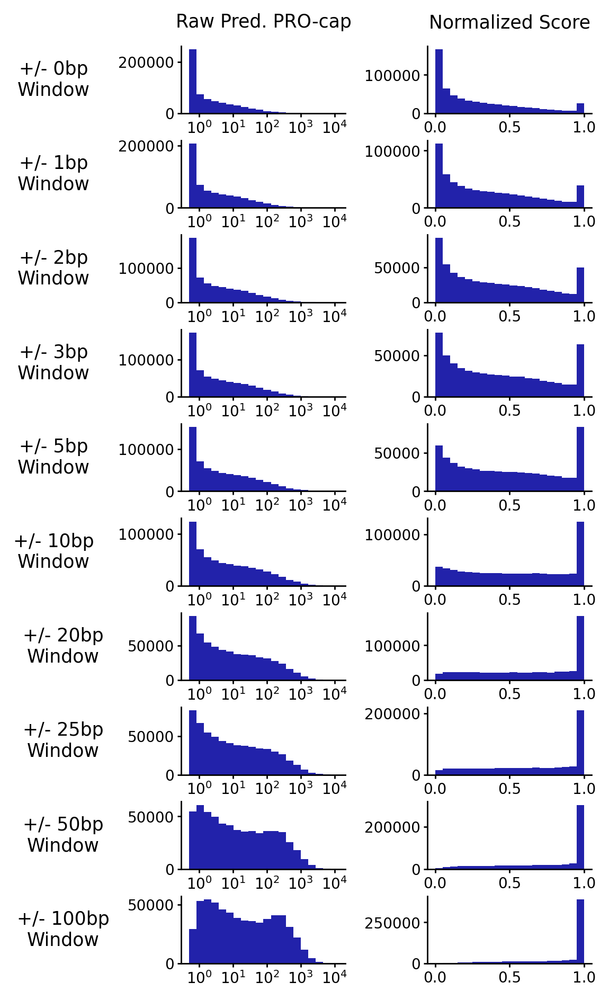

In [282]:
def plot_merged_scores_by_type(merged_scores_to_plot, title):
    if num_score_types == 3:
        fig, axes = plt.subplots(num_score_windows, num_score_types,
                                 figsize=(6.4, 10), dpi=250)
    else:
        fig, axes = plt.subplots(num_score_windows, num_score_types,
                                 figsize=(4, 9), dpi=250)

    for row_i in range(num_score_types):
        for col_i in range(num_score_windows):
            ax = axes[col_i][row_i]
            score_name = score_names_lists[row_i][col_i]

            to_plot = merged_scores_to_plot[score_name]

            if "norm" not in score_name:
                to_plot = np.log10(to_plot + 0.5)

            ax.hist(to_plot, bins=20, color="#2222AA")

            ax.tick_params(pad=2, length=2, labelsize=8)
            ax.spines[["top", "right"]].set_visible(False)

            extend_by = score_name.split("extended_")[1]
            axes[col_i][0].set_ylabel("+/- " + str(extend_by) + "\nWindow", rotation=0,
                                      verticalalignment="center", labelpad=35, fontsize=10)
            
            axes[col_i][0].set_xticks(range(5), [r'$10^' + str(i) + '$' for i in range(5)])

    if len(axes[0]) == 3:
        axes[0][0].set_title("Raw Scores (Log10)", fontsize=10)
        axes[0][1].set_title("Norm. Scores", fontsize=10)
        axes[0][2].set_title("Log-Norm. Scores", fontsize=10)
    else:
        axes[0][0].set_title("Raw Pred. PRO-cap", fontsize=10, y=1.11)
        axes[0][1].set_title("Normalized Score", fontsize=10, y=1.1)

    #plt.suptitle(title, fontsize=10, y=0.95)
    fig.subplots_adjust(hspace=0.4, wspace=0.5)
    
    plt.show()
    
    
plot_merged_scores_by_type(merged_scores["top3"], "Cell-Average Scores")
#plot_merged_scores_by_type(merged_scores["max"], "Cell-Max Scores")

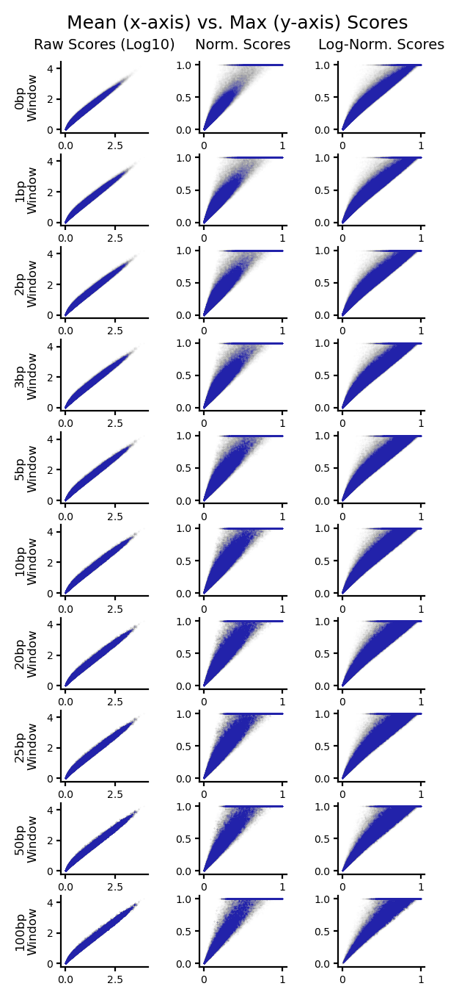

In [74]:
def plot_compare_scores_mean_vs_max(merged_scores):
    fig, axes = plt.subplots(num_score_windows, num_score_types,
                             figsize=(3.2, 8), dpi=200)

    for row_i in range(num_score_types):
        for col_i in range(num_score_windows):
            ax = axes[col_i][row_i]
            score_name = score_names_lists[row_i][col_i]

            to_plot_x = merged_scores["mean"][score_name]
            to_plot_y = merged_scores["max"][score_name]

            if "norm" not in score_name:
                to_plot_x = np.log10(to_plot_x + 1)
                to_plot_y = np.log10(to_plot_y + 1)

            ax.scatter(to_plot_x, to_plot_y, alpha=0.003, s=1, color="#2222AA", linewidths=0)

            ax.tick_params(labelsize=5, pad=2, length=2)
            ax.spines[["top", "right"]].set_visible(False)

            axes[col_i][0].set_ylabel(str(extend_bys[col_i]) + "bp\nWindow",
                                     fontsize=6)

    axes[0][0].set_title("Raw Scores (Log10)", fontsize=7)
    axes[0][1].set_title("Norm. Scores", fontsize=7)
    axes[0][2].set_title("Log-Norm. Scores", fontsize=7)

    plt.suptitle("Mean (x-axis) vs. Max (y-axis) Scores", fontsize=9, y=0.92)
    fig.subplots_adjust(hspace=0.3, wspace=0.6)
    plt.show()
    
    
plot_compare_scores_mean_vs_max(merged_scores)

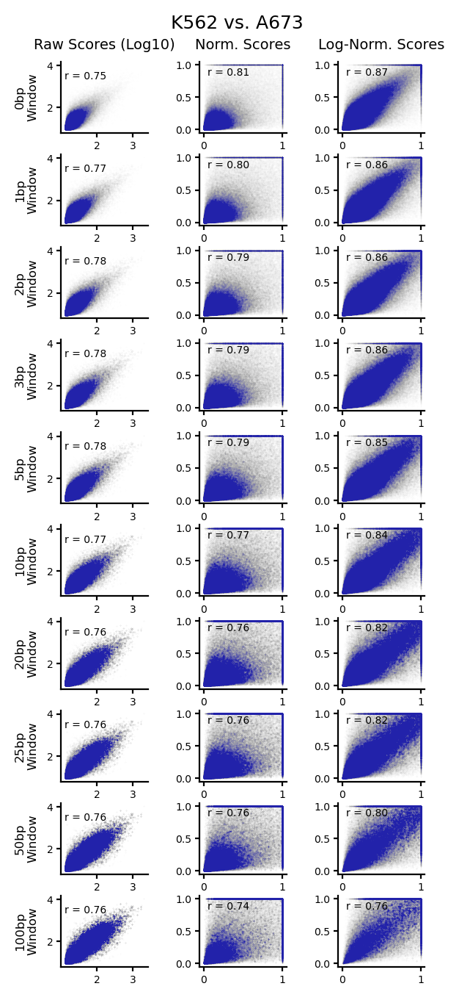

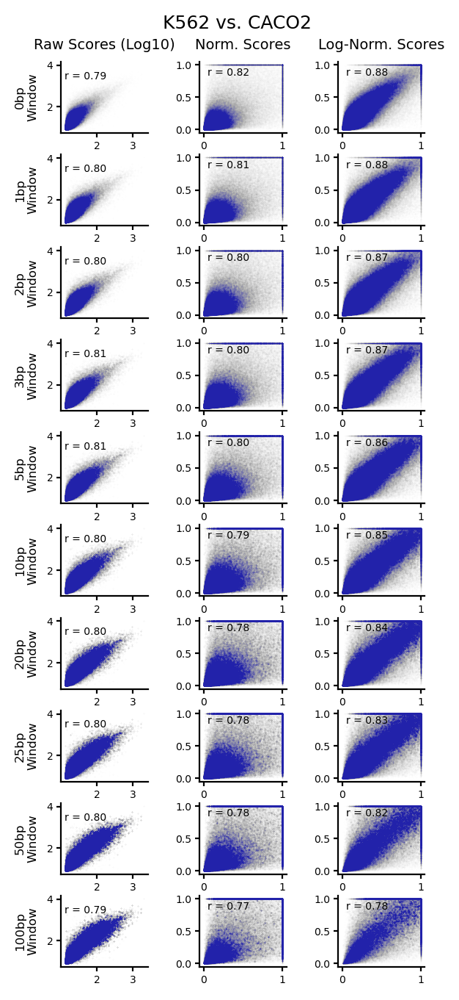

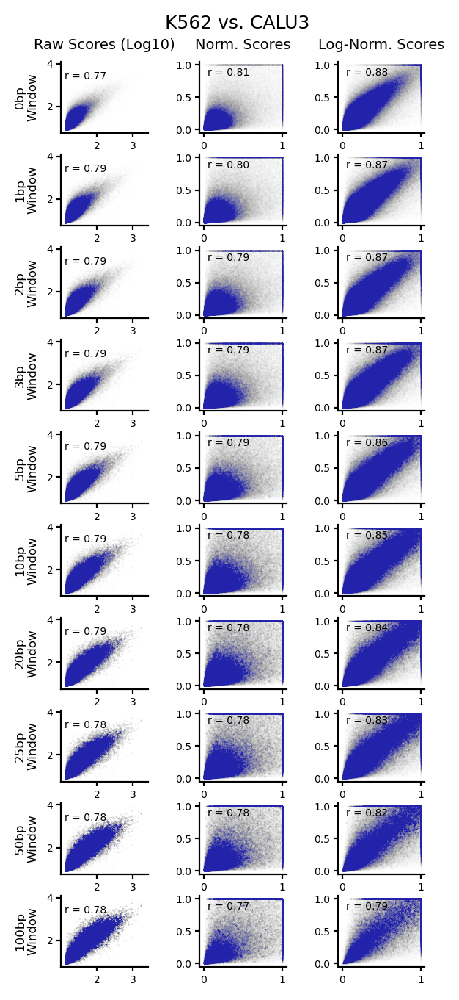

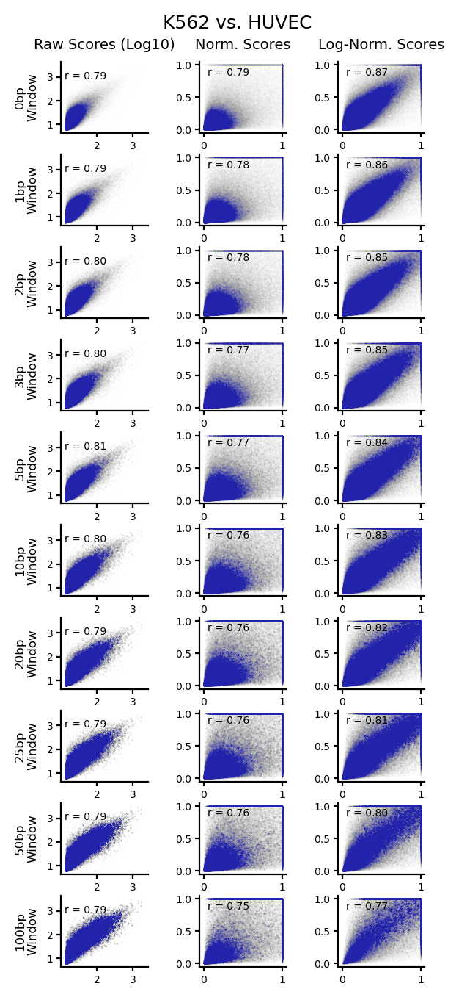

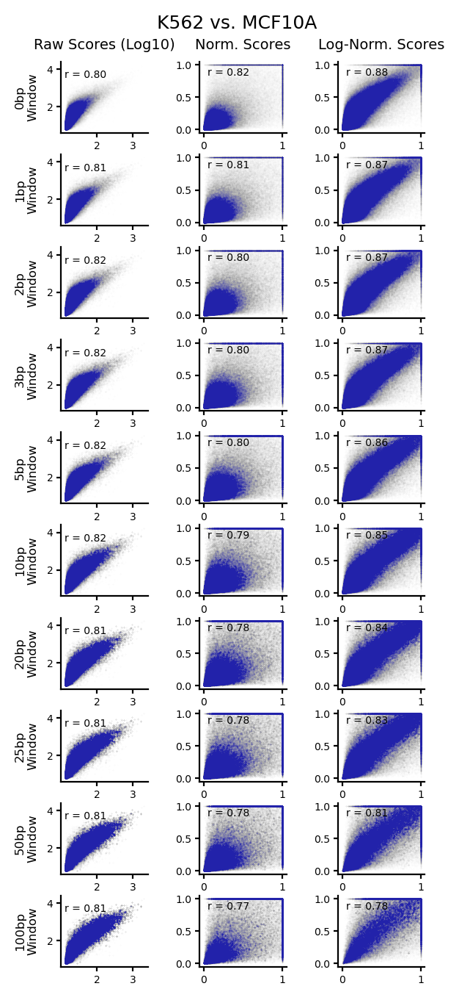

...

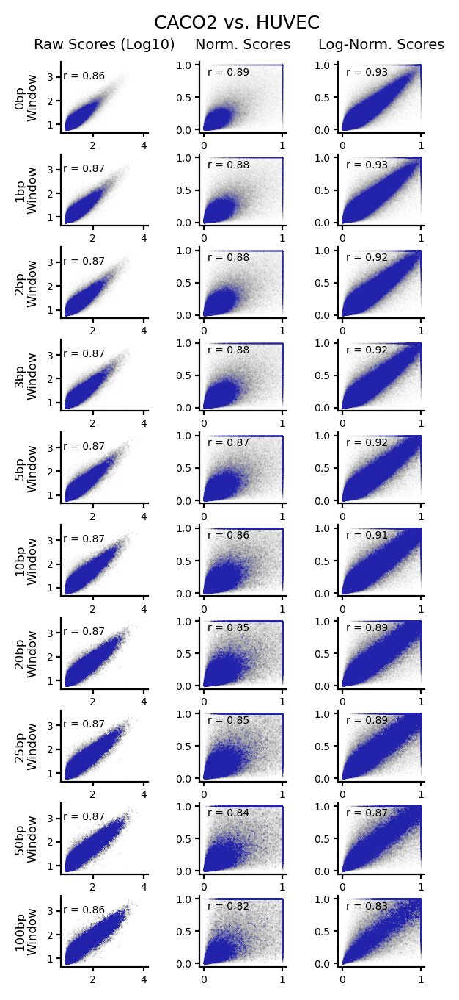

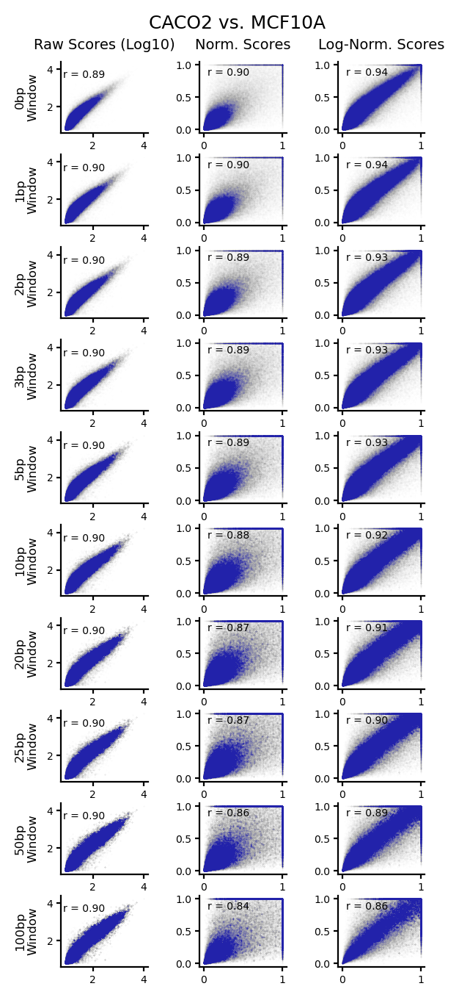

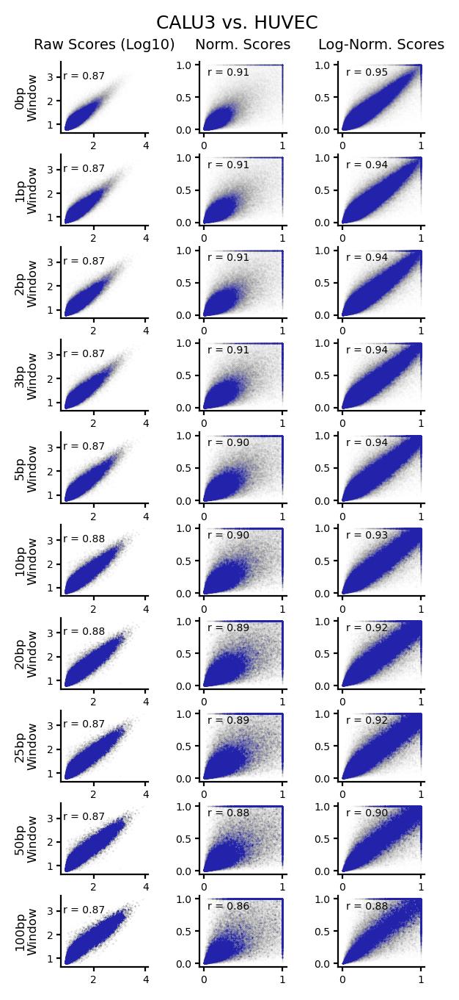

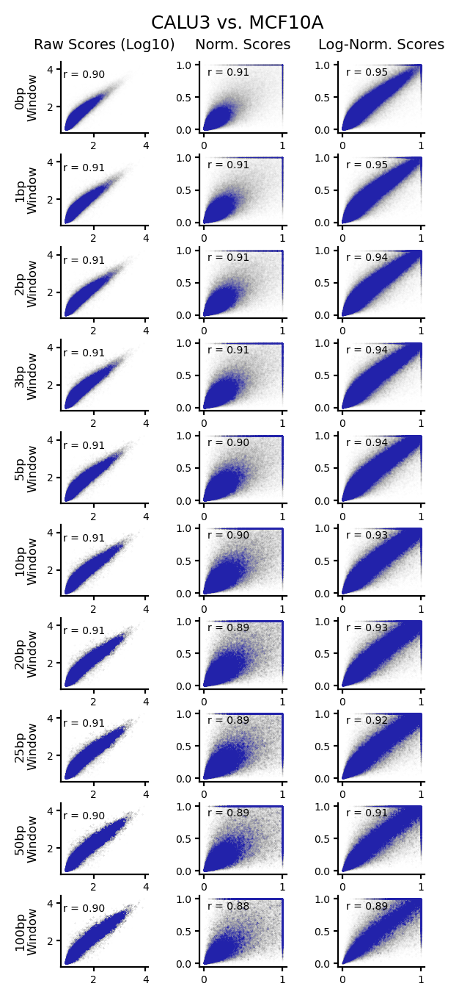

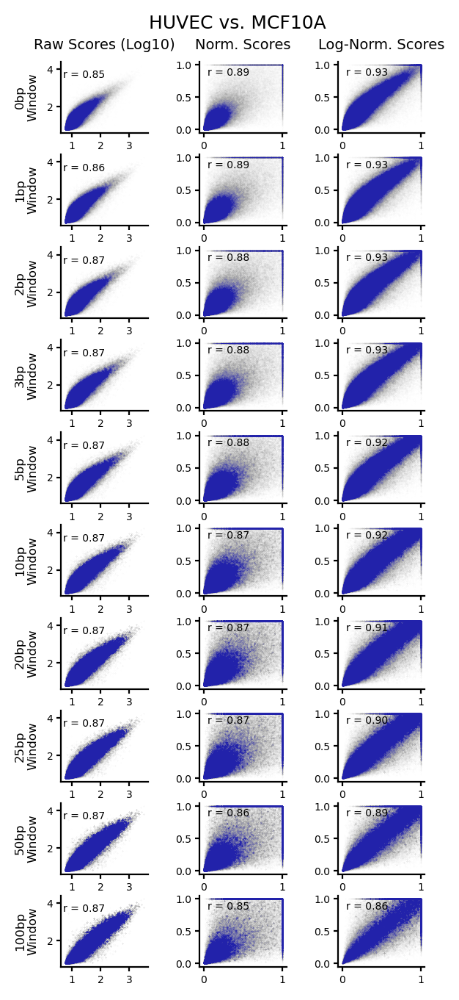

In [90]:
def plot_cell_type_pair_compare_scores(cell_type1, cell_type2, cell_type_scores):
    fig, axes = plt.subplots(num_score_windows, num_score_types,
                             figsize=(3.2, 8), dpi=200)

    for row_i in range(num_score_types):
        for col_i in range(num_score_windows):
            ax = axes[col_i][row_i]
            score_name = score_names_lists[row_i][col_i]

            to_plot_x = cell_type_scores[cell_type1][score_name]
            to_plot_y = cell_type_scores[cell_type2][score_name]

            if "norm" not in score_name:
                to_plot_x = np.log10(to_plot_x + 1)
                to_plot_y = np.log10(to_plot_y + 1)

            ax.scatter(to_plot_x, to_plot_y, alpha=0.003, s=1, color="#2222AA", linewidths=0)

            ax.tick_params(labelsize=5, pad=2, length=2)
            ax.spines[["top", "right"]].set_visible(False)

            axes[col_i][0].set_ylabel(str(extend_bys[col_i]) + "bp\nWindow",
                                     fontsize=6)
            
            pearson_r = np.corrcoef(cell_type_scores[cell_type1][score_name],
                                    cell_type_scores[cell_type2][score_name])[0,1]
            ax.text(max(ax.get_xlim()[0] * 1.1, 0.05), ax.get_ylim()[1] * 0.8,
                     "r = %0.2f" % pearson_r, fontsize=5)

    axes[0][0].set_title("Raw Scores (Log10)", fontsize=7)
    axes[0][1].set_title("Norm. Scores", fontsize=7)
    axes[0][2].set_title("Log-Norm. Scores", fontsize=7)

    plt.suptitle(cell_type1 + " vs. " + cell_type2, fontsize=9, y=0.92)
    fig.subplots_adjust(hspace=0.3, wspace=0.6)
    plt.show()
    

for cell_type1 in cell_types:
    for cell_type2 in cell_types:
        if cell_types.index(cell_type1) < cell_types.index(cell_type2):
            plot_cell_type_pair_compare_scores(cell_type1, cell_type2,
                                               cell_type_scores)

In [26]:
SUPPORT_TYPES = ['cagePolyASupported', 'cageOnlySupported', 'polyAOnlySupported', 'noCageNoPolyASupported']
SEQ_TECHS = ['ont,pacBioSII', "ont", "pacBioSII"]
CAPTURE_TYPES = ["pre-capture", "post-capture", "post-capture,pre-capture"]

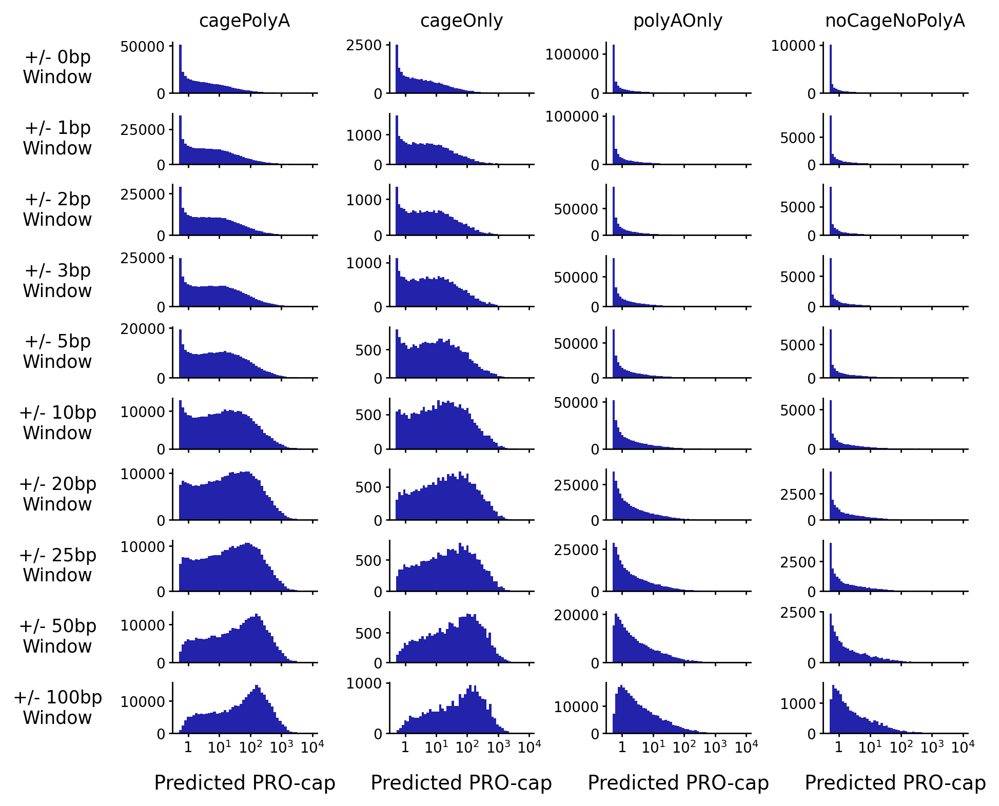

In [284]:
def plot_hist_scores_by_support_type(scores_df, score_names, log_scores = False,
                                     xlabel="ProCapNet Score"):
    
    fig, axes = plt.subplots(len(score_names), len(SUPPORT_TYPES),
                             figsize=(8,7), sharex=True, dpi=250)
    
    for row_i, score_name in enumerate(score_names):
        if log_scores:
            scores_row = np.log10(scores_df[score_name] + 0.5)
        else:
            scores_row = scores_df[score_name]
            
        support_types = np.array([SUPPORT_TYPES.index(support) for support in scores_df["support"]])
    
        for col_i in range(len(SUPPORT_TYPES)):
            axes[row_i, col_i].hist(scores_row[support_types == col_i],
                                    alpha = 1, color="#2222AA",
                                    bins = 50)#np.arange(0,3.5,0.15))

            if row_i == 0:
                axes[row_i, col_i].set_title(SUPPORT_TYPES[col_i].replace("Supported", ""), fontsize=10, y=1.1)
            
            axes[row_i, col_i].spines[["top", "right"]].set_visible(False)

            if row_i == len(score_names) - 1:
                axes[row_i, col_i].set_xlabel(xlabel,
                                      fontsize=11, labelpad=10)
                
                if log_scores:
                    axes[row_i, col_i].set_xticks([0,1,2,3,4], ["1", r'$10^1$', r'$10^2$', r'$10^3$', r'$10^4$'])

            if col_i == 0:
                extend_by = score_name.split("extended_")[1]
                axes[row_i, col_i].set_ylabel("+/- " + str(extend_by) + "\nWindow", rotation=0,
                                      verticalalignment="center", labelpad=35, fontsize=10)
                
            axes[row_i, col_i].tick_params(pad=2, length=2, labelsize=8)
                
    fig.align_ylabels(axes)
    plt.subplots_adjust(hspace=0.4, wspace=0.5)
    
    plt.show()
    

plot_hist_scores_by_support_type(merged_scores["mean"], raw_score_names,
                                 log_scores=True, xlabel="Predicted PRO-cap")

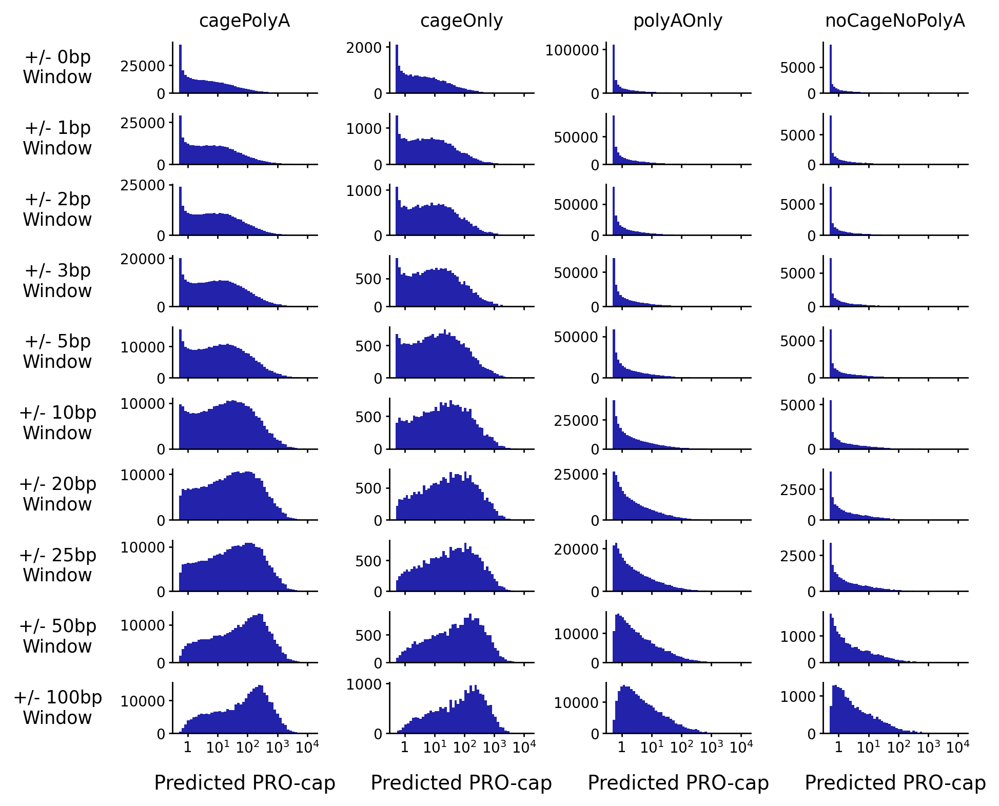

In [285]:
plot_hist_scores_by_support_type(merged_scores["top3"], raw_score_names,
                                 log_scores=True, xlabel="Predicted PRO-cap")

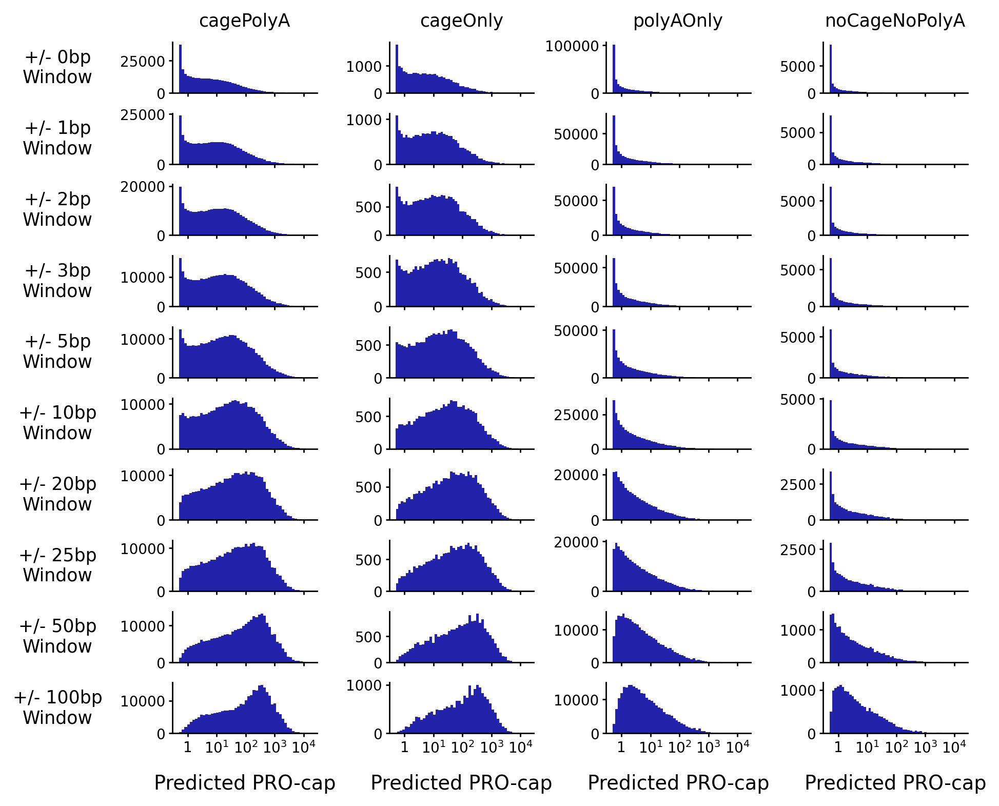

In [58]:
plot_hist_scores_by_support_type(merged_scores["max"], raw_score_names,
                                 log_scores=True, xlabel="Predicted PRO-cap")

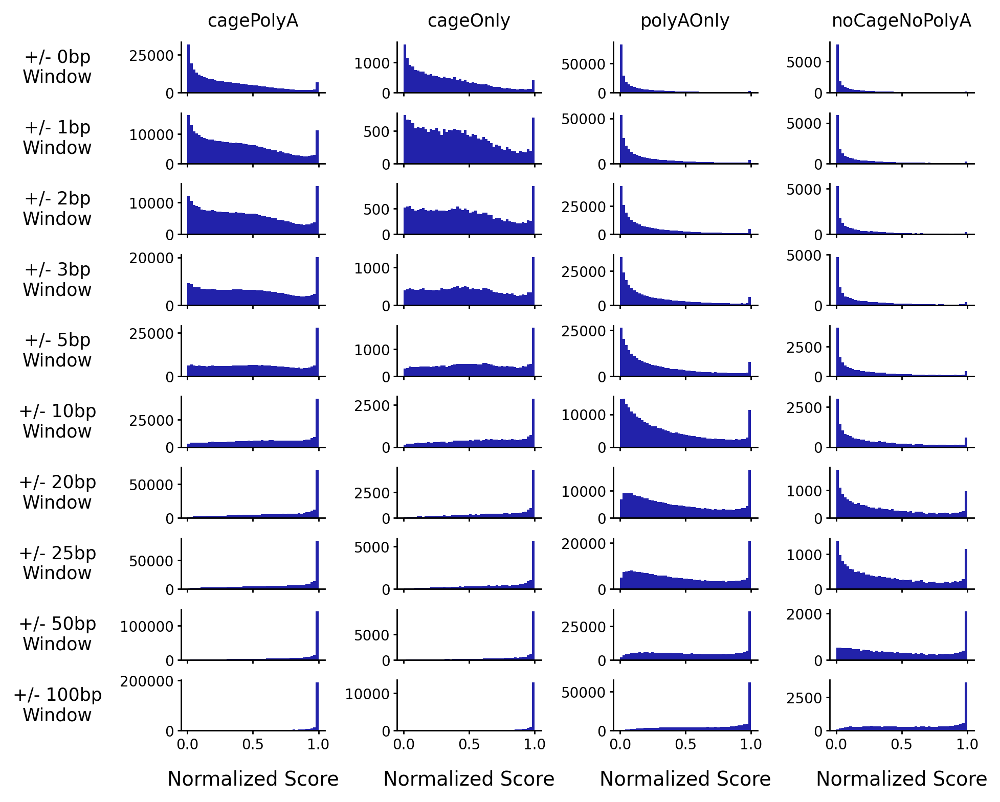

In [286]:
plot_hist_scores_by_support_type(merged_scores["mean"], log_norm_score_names, log_scores=False,
                                 xlabel="Normalized Score")

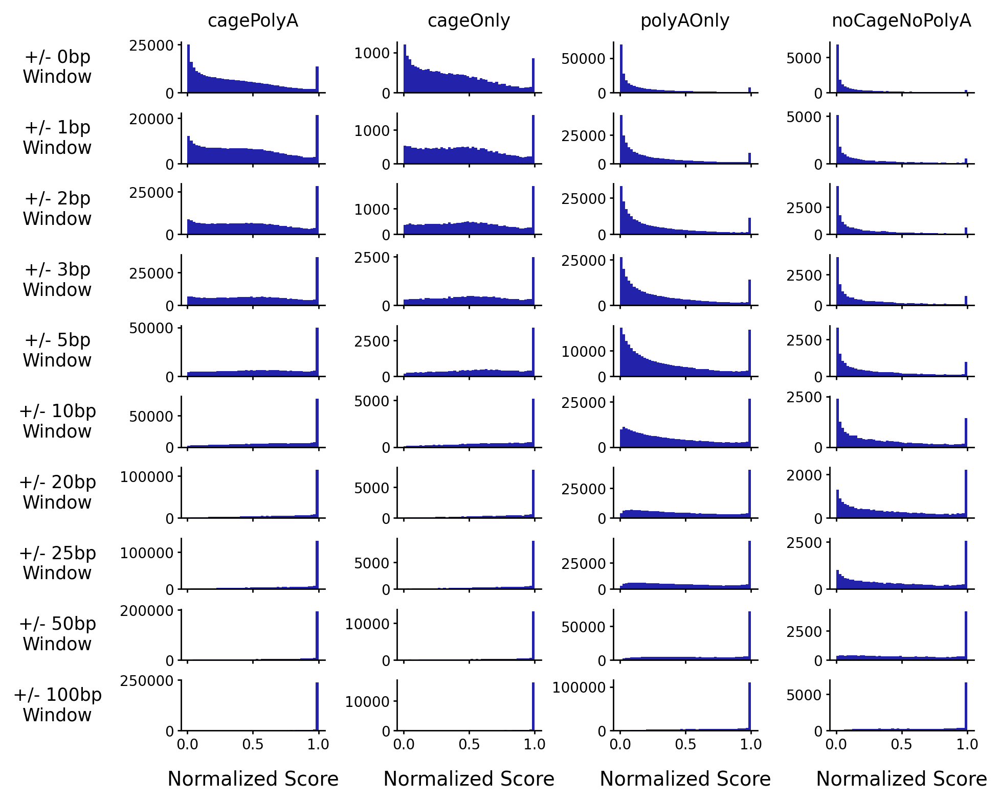

In [287]:
plot_hist_scores_by_support_type(merged_scores["top3"], log_norm_score_names, log_scores=False,
                                 xlabel="Normalized Score")

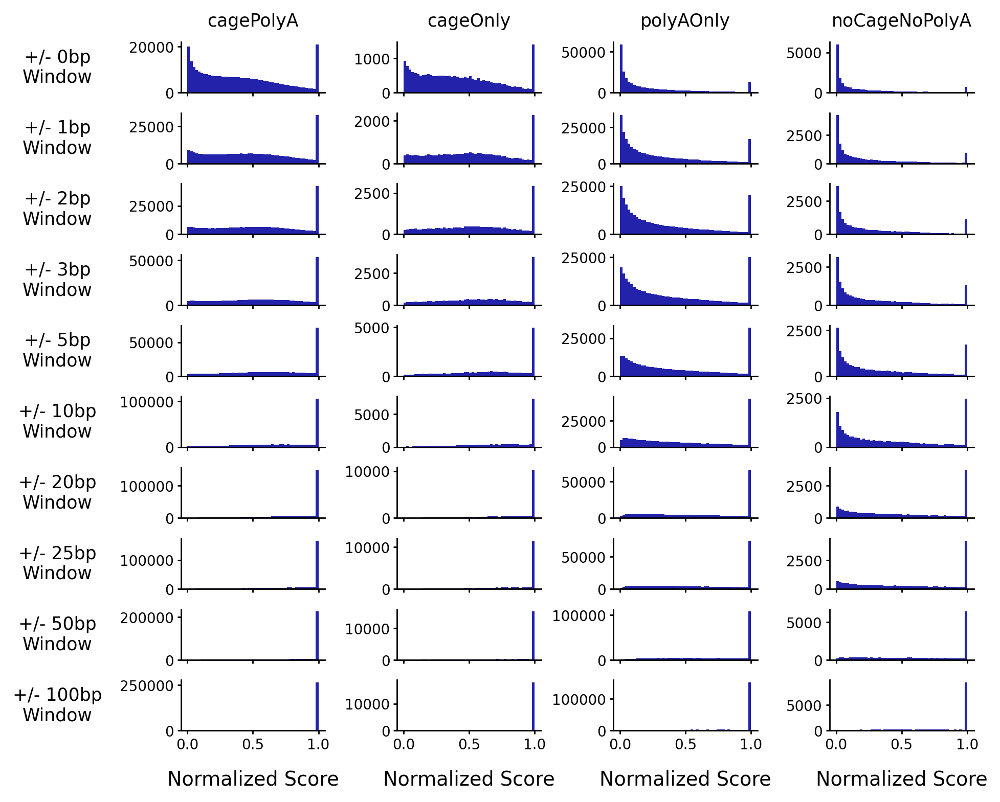

In [62]:
plot_hist_scores_by_support_type(merged_scores["max"], log_norm_score_names, log_scores=False,
                                 xlabel="Normalized Score")

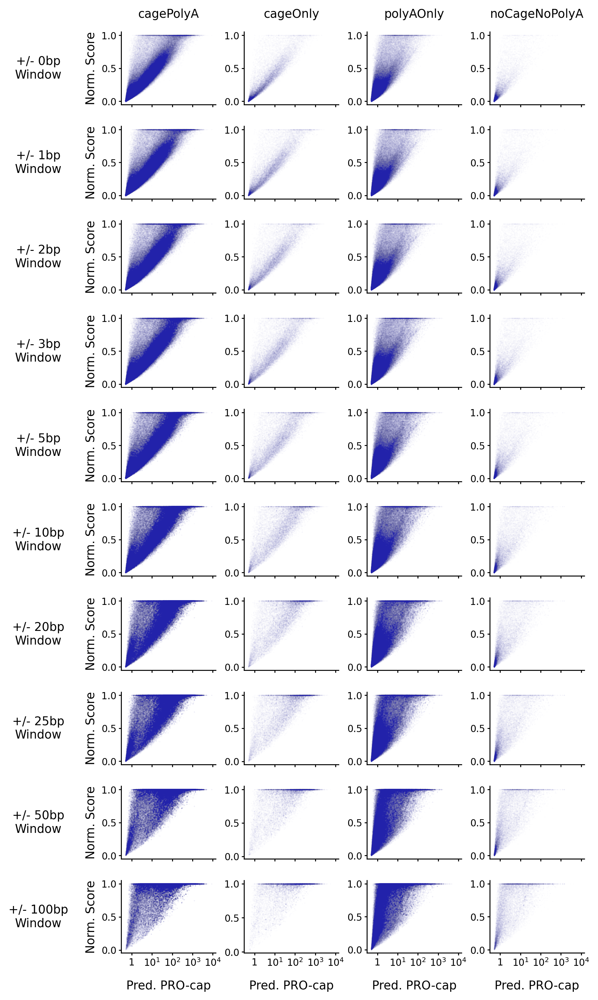

In [75]:
def plot_scatter_scores_by_support_type(scores_df, score_names, log_norm_score_names):
    assert len(score_names) == len(log_norm_score_names)
    
    fig, axes = plt.subplots(len(score_names), len(SUPPORT_TYPES),
                             figsize=(7,14), sharex=True, dpi=250)
    
    for row_i in range(len(score_names)):
        scores_row_x = np.log10(scores_df[score_names[row_i]] + 0.5)
        scores_row_y = scores_df[log_norm_score_names[row_i]]
            
        support_types = np.array([SUPPORT_TYPES.index(support) for support in scores_df["support"]])
    
        for col_i in range(len(SUPPORT_TYPES)):
            axes[row_i, col_i].scatter(scores_row_x[support_types == col_i],
                                       scores_row_y[support_types == col_i],
                                       alpha=0.01, s=1, color="#2222AA", linewidths=0)

            if row_i == 0:
                axes[row_i, col_i].set_title(SUPPORT_TYPES[col_i].replace("Supported", ""), fontsize=10, y=1.1)
            
            axes[row_i, col_i].spines[["top", "right"]].set_visible(False)

            if row_i == len(score_names) - 1:
                axes[row_i, col_i].set_xlabel("Pred. PRO-cap",
                                      fontsize=10, labelpad=10)
                
                axes[row_i, col_i].set_xticks([0,1,2,3,4], ["1", r'$10^1$', r'$10^2$', r'$10^3$', r'$10^4$'])

            if col_i == 0:
                extend_by = score_names[row_i].split("extended_")[1]
                
                axes[row_i, col_i].set_ylabel("Norm. Score", fontsize=10)
                
                ax_copy = axes[row_i, col_i].twinx()
                ax_copy.yaxis.set_label_position('left')
                ax_copy.set_yticks([])
                ax_copy.spines[["top", "right", "bottom", "left"]].set_visible(False)
                
                ax_copy.set_ylabel("+/- " + str(extend_by) + "\nWindow", rotation=0,
                                      verticalalignment="center", labelpad=70, fontsize=10)
                
            axes[row_i, col_i].tick_params(pad=2, length=2, labelsize=8)
                
    fig.align_ylabels(axes)
    plt.subplots_adjust(hspace=0.3, wspace=0.3)
    
    plt.show()
    

plot_scatter_scores_by_support_type(merged_scores["mean"], raw_score_names, log_norm_score_names)

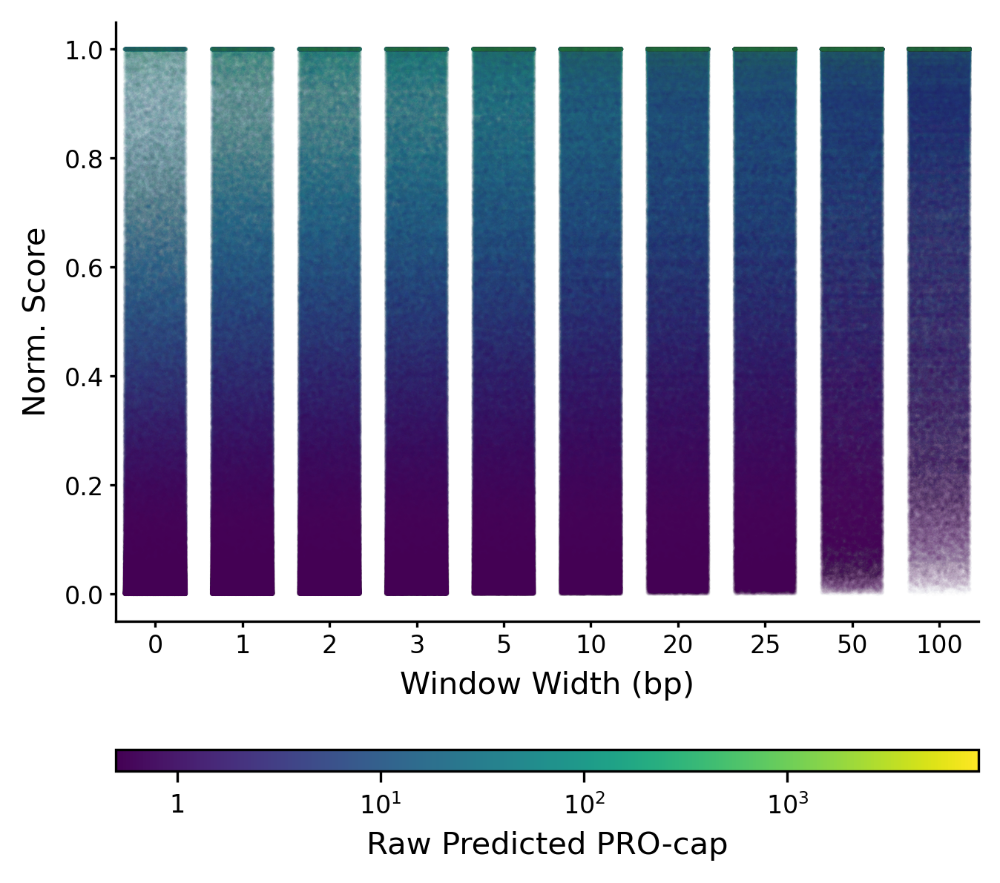

In [114]:
def jitter_dots(dots, jitter_by=0.35, along_y=False):
    offsets = dots.get_offsets()
    jittered_offsets = offsets
    # only jitter in the x-direction
    if along_y:
        jittered_offsets[:, 1] += np.random.uniform(-jitter_by,
                                                jitter_by,
                                                offsets.shape[0])
    else:
        jittered_offsets[:, 0] += np.random.uniform(-jitter_by,
                                                    jitter_by,
                                                    offsets.shape[0])
    dots.set_offsets(jittered_offsets)


def plot_scatter_scores_window_on_x(scores_df, score_names, log_norm_score_names):
    assert len(score_names) == len(log_norm_score_names)
    
    fig, axes = plt.subplots(figsize=(5,5), dpi=300)
    
    scores_colors = []
    scores_ys = []
    scores_xs = []
    
    for row_i in range(len(score_names)):
        scores_color = np.log10(scores_df[score_names[row_i]] + 0.5)
        scores_y = scores_df[log_norm_score_names[row_i]]
        
        assert len(scores_color) == len(scores_y)
        
        scores_colors.extend(scores_color)
        scores_ys.extend(scores_y)
        scores_xs.extend([row_i] * len(scores_y))
            
    scores_colors = np.array(scores_colors)
    scores_ys = np.array(scores_ys)
    scores_xs = np.array(scores_xs)
    
    dots = plt.scatter(scores_xs,
                        scores_ys,
                        c=scores_colors,
                        alpha=0.01, s=2, linewidths=0)
        
    jitter_dots(dots)
    
    plt.gca().spines[["top", "right"]].set_visible(False)

    plt.xlabel("Window Width (bp)", fontsize=10)

    plt.xticks(range(len(extend_bys) - 1), extend_bys[:-1])

    plt.ylabel("Norm. Score", fontsize=10)

    plt.gca().tick_params(pad=2, length=2, labelsize=8)
    
    cbar = fig.colorbar(dots, location="bottom", aspect=40)
    cbar.solids.set(alpha=1)
    cbar.set_ticks(range(4))
    cbar.ax.set_xticklabels(["1", r'$10^1$', r'$10^2$', r'$10^3$'], fontsize=8)
    cbar.ax.set_xlabel("Raw Predicted PRO-cap", fontsize=10)
    
    plt.show()
    

plot_scatter_scores_window_on_x(merged_scores["mean"], raw_score_names, log_norm_score_names)

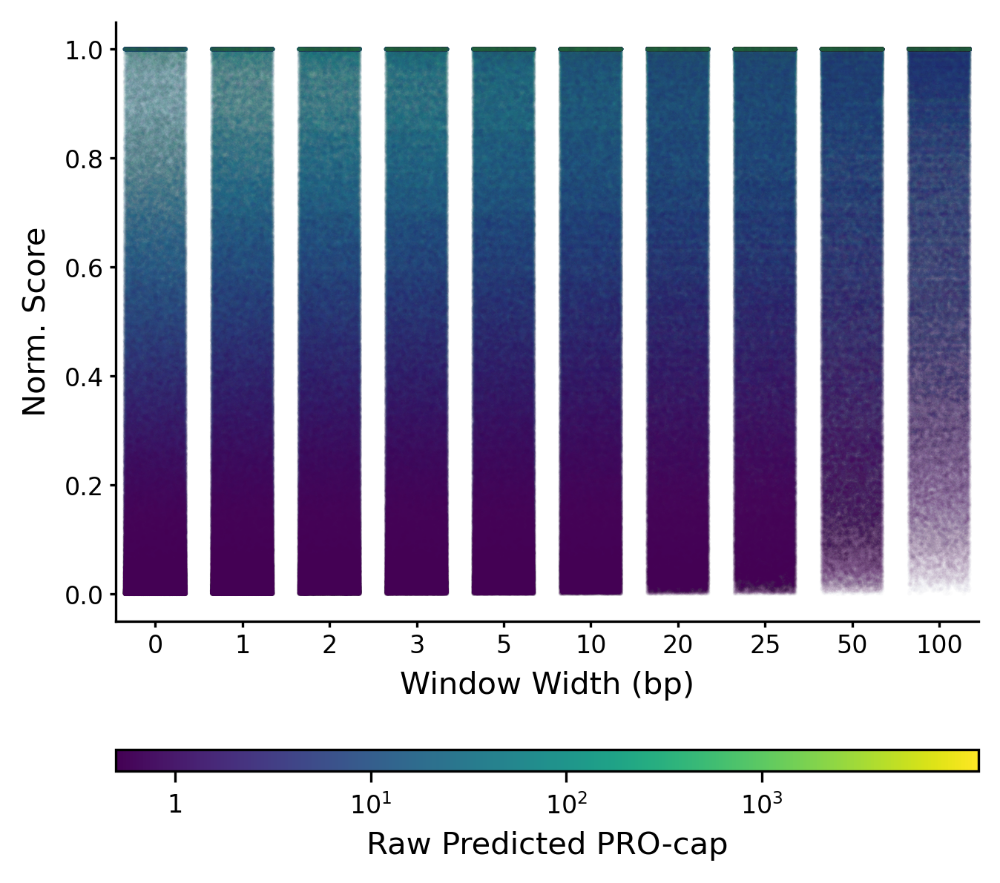

In [288]:
plot_scatter_scores_window_on_x(merged_scores["top3"], raw_score_names, log_norm_score_names)

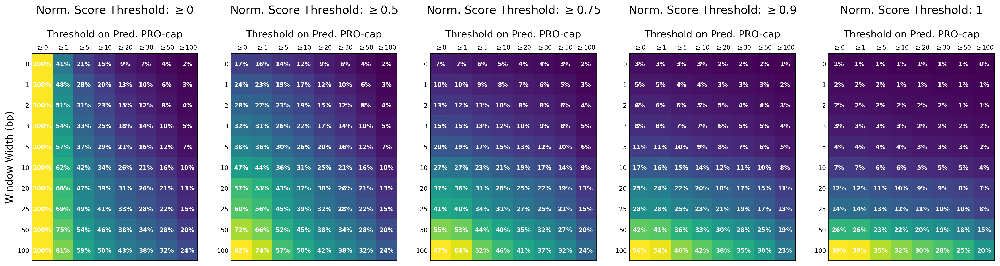

In [295]:
def plot_thresholds_heatmaps(scores_df, score_names, log_norm_score_names):
    assert len(score_names) == len(log_norm_score_names)
    
    norm_score_threshs = [0, 0.5, 0.75, 0.9, 1]
    raw_score_threshs = [0, 1, 5, 10, 20, 30, 50, 100]
    
    fig, axes = plt.subplots(1, len(norm_score_threshs),
                             figsize=(4.6 * len(norm_score_threshs),5), dpi=250)
    
    for ax_i, norm_score_thresh in enumerate(norm_score_threshs):
        heatmap_counts = np.empty((len(score_names), len(raw_score_threshs)))
        
        for row_i in range(len(score_names)):
            raw_scores = scores_df[score_names[row_i]]
            norm_scores = scores_df[log_norm_score_names[row_i]]

            assert len(raw_scores) == len(norm_scores)

            for col_i, raw_score_thresh in enumerate(raw_score_threshs):
                passing_raw_thresh = raw_scores >= raw_score_thresh
                passing_norm_thresh = norm_scores >= norm_score_thresh
                passing_threshs = passing_raw_thresh * passing_norm_thresh

                heatmap_counts[row_i, col_i] = np.sum(passing_threshs)

        ax = axes[ax_i]
        ax.imshow(heatmap_counts, aspect="auto")
        
        ax.set_xticks(range(len(raw_score_threshs)), [r'$\geq' + str(t) + r'$' for t in raw_score_threshs])
        ax.set_yticks(range(len(extend_bys) - 1), extend_bys[:-1])
        
        if ax_i == 0:
            ax.set_ylabel("Window Width (bp)", fontsize=13)
        
        ax.set_xlabel("Threshold on Pred. PRO-cap", fontsize=13, labelpad=10)
        
        ax.xaxis.set_ticks_position("top")
        ax.xaxis.set_label_position("top")
        ax.tick_params(length=0, labelsize=8)
        
        # add text on top of heatmaps
        for i in range(heatmap_counts.shape[0]):
            for j in range(heatmap_counts.shape[1]):
                num = (100 * int(heatmap_counts[i,j]) / scores_df.shape[0])
                if heatmap_counts[i,j] < 0.005:
                    num_str = "%0.1f" % (num) + "%"
                else:
                    num_str = "%0.f" % (num) + "%"
                text = ax.text(j, i+0.02, num_str,
                            ha="center", va="center", color="w", fontsize=8, weight="bold")
                
        if norm_score_thresh < 1:
            ax.set_title(r'Norm. Score Threshold: $\geq$' + str(norm_score_thresh), fontsize=15, y=1.17)
        else:
            ax.set_title('Norm. Score Threshold: 1', fontsize=15, y=1.17)
        
    plt.show()
    
plot_thresholds_heatmaps(merged_scores["mean"], raw_score_names, log_norm_score_names)

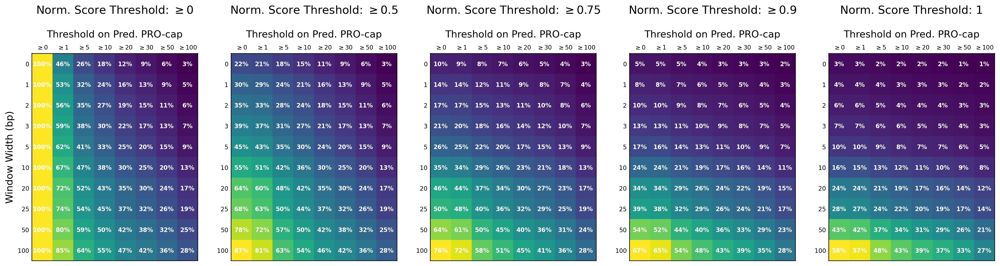

In [296]:
plot_thresholds_heatmaps(merged_scores["top3"], raw_score_names, log_norm_score_names)

In [170]:
tmp = merged_scores["mean"]["score_window_extended_5bp"] >= 100
tmp *= merged_scores["mean"]["score_log_norm_window_extended_10bp"] < 1

tmp2 = merged_scores["mean"][tmp][["chrom", "start", "end"]]

tmp2[tmp2["chrom"] == "chr1"]

,chrom,start,end
2440,chr1,181088,181089
2444,chr1,181116,181117
2445,chr1,181124,181125
2446,chr1,181126,181127
2447,chr1,181129,181130
...,...,...,...
61944,chr1,247210886,247210887
61945,chr1,247210889,247210890
62186,chr1,248692116,248692117
62226,chr1,248826328,248826329


In [261]:
def get_indexes_passing_thresh(scores_df, extend_by, raw_thresh, norm_thresh=0):
    raw_scores = scores_df["score_window_extended_" + str(extend_by) + "bp"]
    passing = raw_scores >= raw_thresh
    
    if norm_thresh > 0:
        norm_scores = scores_df["score_log_norm_window_extended_" + str(extend_by) + "bp"]
        passing *= norm_scores >= norm_thresh
        
    return np.where(passing)[0]

def label_TSSs_by_support(scores_df):
    support_labels = np.array(["no_support"] * len(scores_df), dtype="<U25")
    
    def label(label_str, where):
        for index in where:
            if support_labels[index] == "no_support":
                support_labels[index] = label_str
    
    
    where_support = get_indexes_passing_thresh(scores_df, extend_by=5, raw_thresh=500)
    label("highest_precise_support", where_support)
            
    where_support = get_indexes_passing_thresh(scores_df, extend_by=25, raw_thresh=500)
    label("highest_local_support", where_support)
    
    
    where_support = get_indexes_passing_thresh(scores_df, extend_by=5, raw_thresh=100)
    label("high_precise_support", where_support)
    
    where_support = get_indexes_passing_thresh(scores_df, extend_by=25, raw_thresh=100)
    label("high_local_support", where_support)

    # norm score of 0.75 roughly equates to 1/3 of the max pred. PRO-cap for the window
    where_support = get_indexes_passing_thresh(scores_df, extend_by=5, raw_thresh=20, norm_thresh=0.75)
    label("medium_precise_support", where_support)
    
    where_support = get_indexes_passing_thresh(scores_df, extend_by=25, raw_thresh=20, norm_thresh=0.75)
    label("medium_local_support", where_support)

    where_support = get_indexes_passing_thresh(scores_df, extend_by=100, raw_thresh=20)
    label("medium_region_support", where_support)
    
    # 0.9 corresponds to about 60% of the max pred. PRO-cap in the window
    where_support = get_indexes_passing_thresh(scores_df, extend_by=5, raw_thresh=5, norm_thresh=0.9)
    label("low_precise_support", where_support)

    where_support = get_indexes_passing_thresh(scores_df, extend_by=25, raw_thresh=5, norm_thresh=0.9)
    label("low_local_support", where_support)
    
    where_support = get_indexes_passing_thresh(scores_df, extend_by=100, raw_thresh=5)
    label("low_region_support", where_support)

    where_support = get_indexes_passing_thresh(scores_df, extend_by=25, raw_thresh=0, norm_thresh=0.9)
    label("positioning_only_support", where_support)
    
    return support_labels


support_labels = label_TSSs_by_support(merged_scores["mean"])

In [262]:
set(support_labels)

{'high_local_support',
 'high_precise_support',
 'highest_local_support',
 'highest_precise_support',
 'low_local_support',
 'low_precise_support',
 'low_region_support',
 'medium_local_support',
 'medium_precise_support',
 'medium_region_support',
 'no_support',
 'positioning_only_support'}

In [263]:
tmp = np.unique(support_labels, return_counts=True)
list(zip(*tmp))

[('high_local_support', 43339),
 ('high_precise_support', 31287),
 ('highest_local_support', 10598),
 ('highest_precise_support', 6758),
 ('low_local_support', 13845),
 ('low_precise_support', 10244),
 ('low_region_support', 77649),
 ('medium_local_support', 42592),
 ('medium_precise_support', 34077),
 ('medium_region_support', 92556),
 ('no_support', 229681),
 ('positioning_only_support', 21473)]

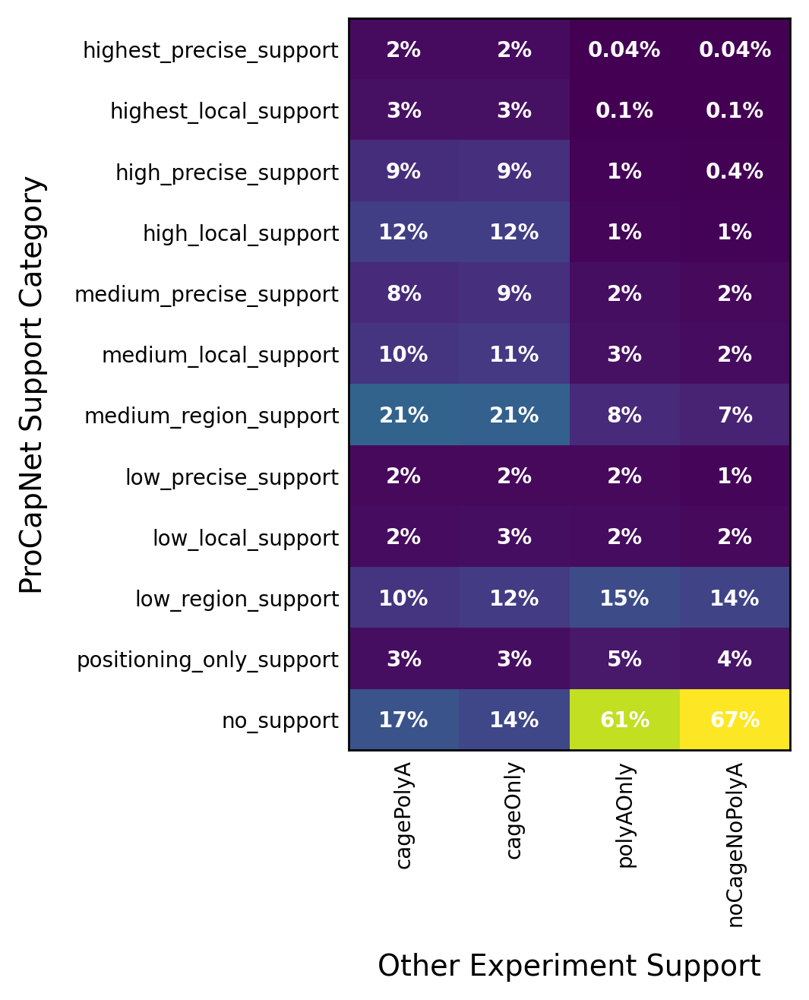

In [264]:
def plot_labels_by_support_type(scores_df, labels):
    label_order = ["highest_precise_support",
                   "highest_local_support",
                   "high_precise_support",
                   "high_local_support",
                   "medium_precise_support",
                   "medium_local_support",
                   "medium_region_support",
                   "low_precise_support",
                   "low_local_support",
                   "low_region_support",
                   "positioning_only_support",
                   "no_support"]
    
    support_types = np.array([SUPPORT_TYPES.index(support) for support in scores_df["support"]])
    
    
    
    heatmap_fracs = np.empty((len(label_order), len(SUPPORT_TYPES)))
    for row_i, label in enumerate(label_order):
        where_label = labels == label
        
        for col_i in range(len(SUPPORT_TYPES)):
            where_support_type = support_types == col_i
            overlap_frac = np.sum(where_label * where_support_type) / np.sum(where_support_type)
            heatmap_fracs[row_i, col_i] = overlap_frac
            
                
    plt.figure(figsize=(3,5), dpi=250)
    ax = plt.gca()
    
    ax.imshow(heatmap_fracs, aspect="auto")

    ax.set_xticks(range(len(SUPPORT_TYPES)),
                  [support.replace("Supported", "") for support in SUPPORT_TYPES],
                  rotation=90)
    ax.set_yticks(range(len(label_order)), label_order)

    ax.set_ylabel("ProCapNet Support Category", fontsize=11, labelpad=10)
    ax.set_xlabel("Other Experiment Support", fontsize=11, labelpad=10)

    #ax.xaxis.set_ticks_position("top")
    #ax.xaxis.set_label_position("top")
    ax.tick_params(length=0, labelsize=8)

    # add text on top of heatmaps
    for i in range(heatmap_fracs.shape[0]):
        for j in range(heatmap_fracs.shape[1]):
            num = heatmap_fracs[i,j] * 100
            if num < 0.5:
                if num < 0.05:
                    num_str = "%0.2f" % (num) + "%"
                else:
                    num_str = "%0.1f" % (num) + "%"
            else:
                num_str = "%0.f" % (num) + "%"
            text = ax.text(j, i+0.02, num_str,
                        ha="center", va="center", color="w", fontsize=8, weight="bold")
        
    plt.show()
    
plot_labels_by_support_type(merged_scores["mean"], support_labels)

In [265]:
support_labels_max = label_TSSs_by_support(merged_scores["max"])

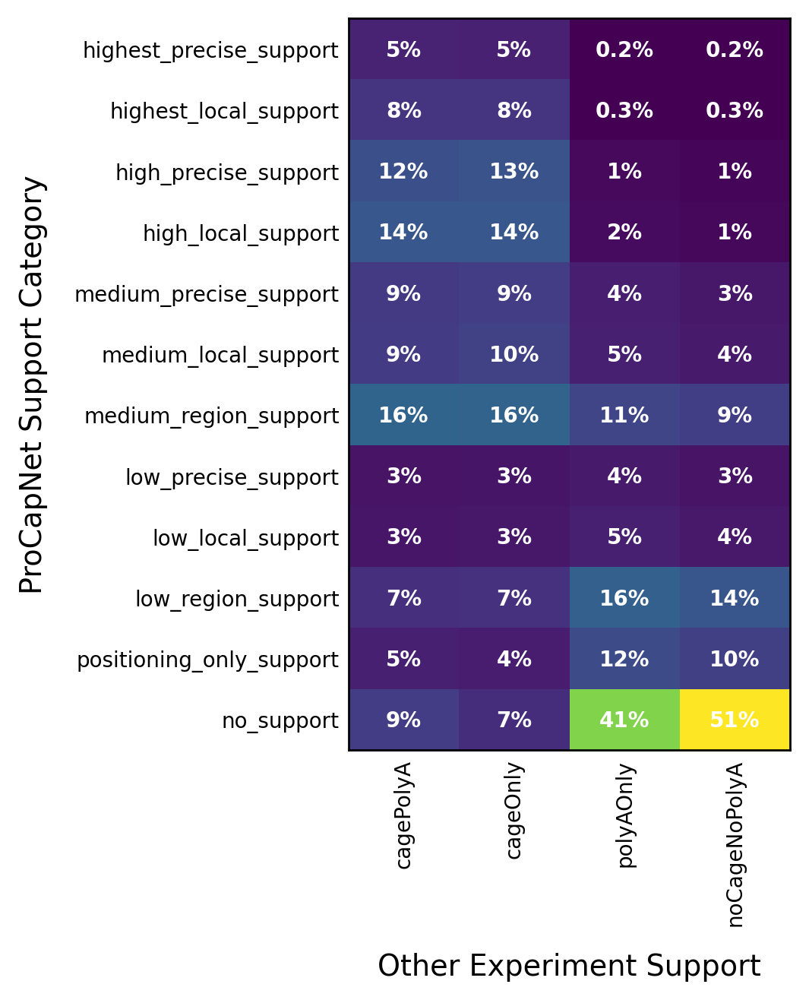

In [266]:
plot_labels_by_support_type(merged_scores["max"], support_labels_max)

In [297]:
tmp = np.unique(support_labels_top3, return_counts=True)
list(zip(*tmp))

[('high_local_support', 48410),
 ('high_precise_support', 38844),
 ('highest_local_support', 17582),
 ('highest_precise_support', 11370),
 ('low_local_support', 19200),
 ('low_precise_support', 15501),
 ('low_region_support', 71715),
 ('medium_local_support', 43374),
 ('medium_precise_support', 38380),
 ('medium_region_support', 87647),
 ('no_support', 185574),
 ('positioning_only_support', 36502)]

In [274]:
support_labels_top3 = label_TSSs_by_support(merged_scores["top3"])

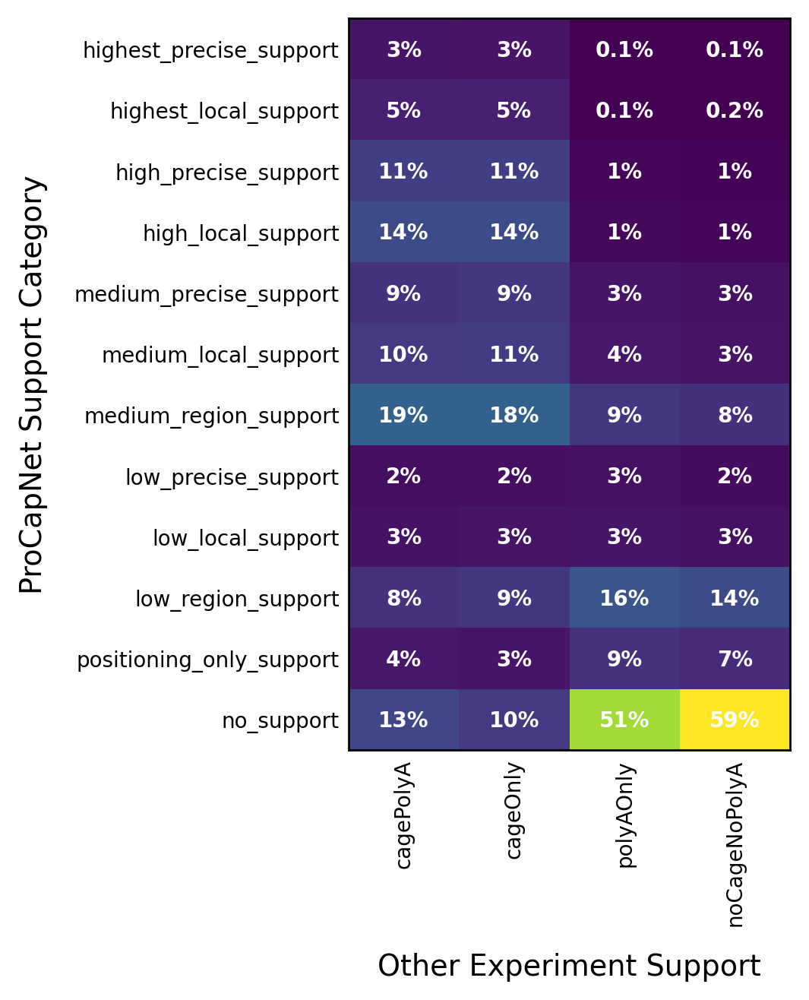

In [275]:
plot_labels_by_support_type(merged_scores["top3"], support_labels_top3)

In [312]:
pd.set_option('display.max_rows', 100)

In [298]:
merged_scores["top3"]["procapnet_support"] = support_labels_top3

In [323]:
tmp = merged_scores["top3"]
tmp2 = tmp[["chrom", "start", "end", "strand", "support", "procapnet_support", "score_window_extended_25bp", "score_log_norm_window_extended_25bp"]]

In [ ]:
'''
chr5:179623290-179623925 hnrnph1
chr1:20682668-20683001 one where huvec and only huvec supports left 2 TSSs over others (low precise, local, region)
'''

In [341]:
tmp2[tmp2["support"] == "cagePolyASupported"].head(n=4500).tail(100)

,chrom,start,end,strand,support,procapnet_support,score_window_extended_25bp,score_log_norm_window_extended_25bp
10932,chr1,23800777,23800778,-,cagePolyASupported,high_precise_support,286.064933,1.000000
10933,chr1,23800780,23800781,-,cagePolyASupported,high_precise_support,232.205840,1.000000
10934,chr1,23800790,23800791,-,cagePolyASupported,high_local_support,232.205840,1.000000
10935,chr1,23800812,23800813,-,cagePolyASupported,medium_region_support,8.426046,0.421640
10936,chr1,23800813,23800814,-,cagePolyASupported,medium_region_support,8.426046,0.421640
10937,chr1,23800817,23800818,-,cagePolyASupported,medium_region_support,8.426046,0.421640
10939,chr1,23800819,23800820,-,cagePolyASupported,medium_region_support,8.426046,0.421640
10940,chr1,23800820,23800821,-,cagePolyASupported,medium_region_support,8.426046,0.421640
10941,chr1,23800827,23800828,-,cagePolyASupported,medium_region_support,8.426046,0.421640
10942,chr1,23800828,23800829,-,cagePolyASupported,medium_region_support,8.426046,0.421640


In [343]:
def load_coords(bed_file, extend_by = 0):
    # loads bed file into list of regions, 1 element in list = 1 row of file
    
    lines = []
    if bed_file.endswith(".gz"):
        with gzip.open(bed_file) as f:
            lines = [line.decode().split() for line in f]
    else:
        with open(bed_file) as f:
            lines = [line.split() for line in f]
    
    coords = [(line[0], int(line[1]) - extend_by, int(line[2]) + extend_by, line[3]) for line in lines]
    return np.array(coords, dtype=object)


TSSs = load_coords(TSSs_filepath)

In [402]:
TSSs_top_100k = TSSs[:50000]

In [403]:
sys.path.append("../figure_notebooks")
from load_annotations_utils import get_labels_of_what_a_overlaps_in_b, format_label_list

motif_hits_bed = "attributions/K562/motif_hits.bed"


def load_annotations(bed_filepath, label=True, label_col=3):
    if bed_filepath.endswith(".gz"):
        with gzip.open(bed_filepath) as f:
            lines = [line.decode().split() for line in f]
    else:
        with open(bed_filepath) as f:
            lines = [line.split() for line in f]

    coords = []
    for line in lines:
        if label:
            chrom, start, end, label = line[0], int(line[1]), int(line[2]), line[label_col]
            coords.append((chrom, start, end, label))
        else:
            chrom, start, end = line[0], int(line[1]), int(line[2])
            coords.append((chrom, start, end))
    return coords


def find_peak_overlap_labels(coords, bed_file_with_labels, overlap_window_width=250):
    # this function finds overlaps between coords and a bed file *with labels*,
    # and tells you what labels overlapped with each of the regions in coords.
    # the functon "find_peak_overlap" is different: it just returns booleans for yes/no overlap
    
    annots = load_annotations(bed_file_with_labels, label=True)

    # get set of chromosomes included in peak set
    chroms = sorted(list(set(coord[0] for coord in coords)))

    # make dict of chromosome --> sorted list of regions + labels
    # (later code will expect sorted input)
    annots_by_chrom = {chrom : sorted([a for a in annots if a[0] == chrom]) for chrom in chroms}
    
    overlaps = []
    for coord_i, coord in enumerate(coords):
        if coord_i % 1000 == 0:
            print(coord_i, len(coords))
        
        chrom, start, end = coord[:3]
        coord_adjust = (chrom, start - overlap_window_width, end + overlap_window_width) ###############
    
        # get list of labels for regions overlapping peak
        overlap_annots_raw = get_labels_of_what_a_overlaps_in_b(coord_adjust, annots_by_chrom[chrom])
    
        overlaps.append(overlap_annots_raw)
    
    # get set of all unique annotation labels that ever overlapped
    all_labels = set([label for label_list in overlaps for label in label_list])
    
    # make dict of label --> list of len(num_peaks),
    # where element i is True if peak i overlapped with that label
    overlaps_dict = dict()
    for label in all_labels:
        overlap_bools = [overlap_label_list.count(label) for overlap_label_list in overlaps]
        overlaps_dict[label] = np.array(overlap_bools)

    return overlaps_dict


motif_hits = find_peak_overlap_labels(TSSs_top_100k, motif_hits_bed) 

0 50000
1000 50000
2000 50000
3000 50000
4000 50000
5000 50000
6000 50000
7000 50000
8000 50000
9000 50000
10000 50000
11000 50000
12000 50000
13000 50000
14000 50000
15000 50000
16000 50000
17000 50000
18000 50000
19000 50000
20000 50000
21000 50000
22000 50000
23000 50000
24000 50000
25000 50000
26000 50000
27000 50000
28000 50000
29000 50000
30000 50000
31000 50000
32000 50000
33000 50000
34000 50000
35000 50000
36000 50000
37000 50000
38000 50000
39000 50000
40000 50000
41000 50000
42000 50000
43000 50000
44000 50000
45000 50000
46000 50000
47000 50000
48000 50000
49000 50000


In [ ]:
# Things to do
# - histogram of motif counts overall
# - histogram split by each of the expt., procapnet support classes
# - distribution of TATA box positions relative to TSS, per support class?

In [358]:
motif_hits["CA-Inr"]

array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 4, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 1, 1, 1, 0, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 1, 1, 1, 1, 1, 2, 0, 0, 0, 0, 0,

In [370]:
motif_hits["ATF1"] = np.zeros((1000,))
motif_hits["YY1"] = np.zeros((1000,))
motif_hits["ZBTB33"] = np.zeros((1000,))
motif_hits["TCT"] = np.zeros((1000,))

In [404]:
motif_names = ["BRE/SP", "CA-Inr", "ETS", "NFY", "NRF1", "ATF1", "TATA",
                   "THAP11", "YY1", "AP1", "TA-Inr", "CTCF", "ZBTB33", "TCT", "TATATA"]

motif_hit_counts = np.array([motif_hits[motif_name] for motif_name in motif_names])

In [405]:
motif_hit_counts.shape

(15, 50000)

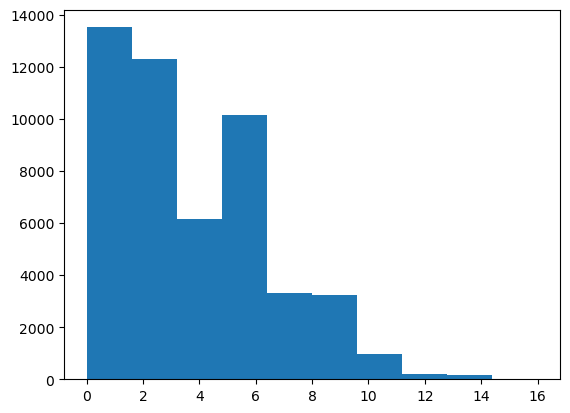

In [406]:
plt.hist(motif_hit_counts.sum(axis=0))
plt.show()

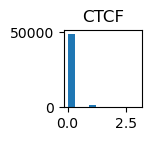

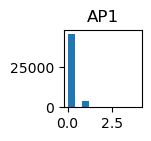

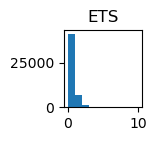

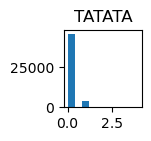

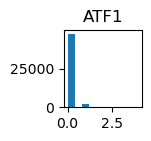

...

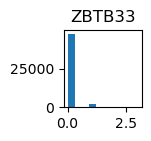

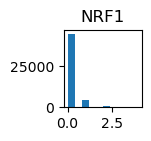

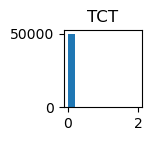

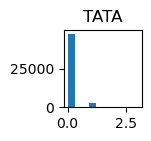

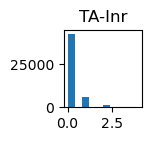

In [407]:
for motif_name in motif_hits.keys():
    plt.figure(figsize=(1,1))
    plt.hist(motif_hits[motif_name])
    plt.title(motif_name)
    plt.show()

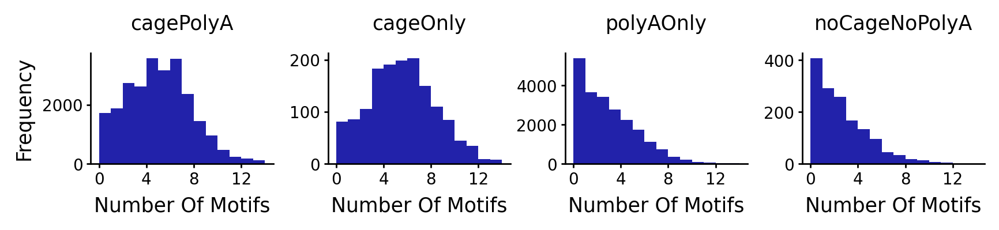

In [413]:
fig, axes = plt.subplots(1, len(SUPPORT_TYPES), figsize=(8,1), dpi=250)

support_types = np.array([SUPPORT_TYPES.index(support) for support in merged_scores["mean"]["support"]])[:50000]

for col_i in range(len(SUPPORT_TYPES)):
    axes[col_i].hist(motif_hit_counts.sum(axis=0)[support_types == col_i],
                            alpha = 1, color="#2222AA",
                            bins = np.arange(15))
    
    axes[col_i].set_title(SUPPORT_TYPES[col_i].replace("Supported", ""), fontsize=10, y=1.1)
    axes[col_i].set_xlabel("Number Of Motifs", fontsize=10, y=1.1)
    
    if col_i == 0:
        axes[col_i].set_ylabel("Frequency", fontsize=10)
    
    axes[col_i].spines[["top", "right"]].set_visible(False)
    
    axes[col_i].set_xticks([0,4,8,12])
    axes[col_i].tick_params(pad=2, length=2, labelsize=8)
                
plt.subplots_adjust(wspace=0.3)
plt.show()

In [389]:
SUPPORT_TYPES2 = ["highest_precise_support",
                   "highest_local_support",
                   "high_precise_support",
                   "high_local_support",
                   "medium_precise_support",
                   "medium_local_support",
                   "medium_region_support",
                   "low_precise_support",
                   "low_local_support",
                   "low_region_support",
                   "positioning_only_support",
                   "no_support"]

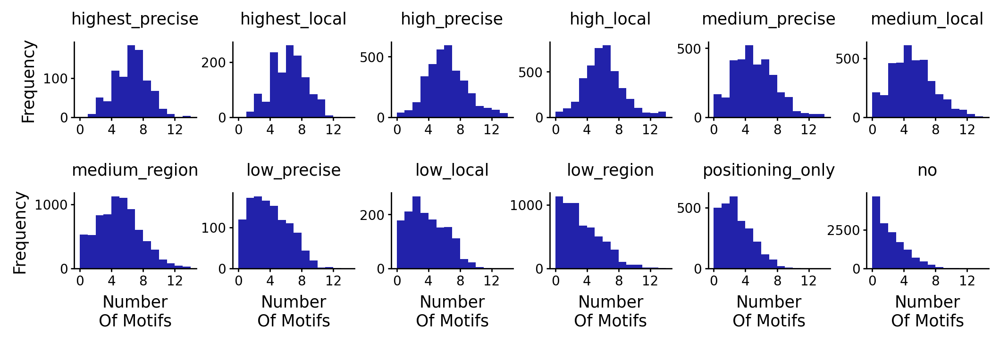

In [412]:
fig, axes = plt.subplots(2, len(SUPPORT_TYPES2) // 2, figsize=(10,2.5), dpi=250)

axes = axes.flatten()

support_types2 = np.array([SUPPORT_TYPES2.index(support) for support in support_labels_top3])[:50000]

for col_i in range(len(SUPPORT_TYPES2)):
    axes[col_i].hist(motif_hit_counts.sum(axis=0)[support_types2 == col_i],
                            alpha = 1, color="#2222AA",
                            bins = np.arange(15))
    
    axes[col_i].set_title(SUPPORT_TYPES2[col_i].replace("_support", ""), fontsize=10, y=1.1)
    
    if col_i > 5:
        axes[col_i].set_xlabel("Number\nOf Motifs", fontsize=10, y=1.1)
    
    if col_i == 0 or col_i == 6:
        axes[col_i].set_ylabel("Frequency", fontsize=10)
    
    axes[col_i].spines[["top", "right"]].set_visible(False)
    
    axes[col_i].set_xticks([0,4,8,12])
    axes[col_i].tick_params(pad=2, length=2, labelsize=8)
                
plt.subplots_adjust(hspace=1, wspace=0.3)
plt.show()

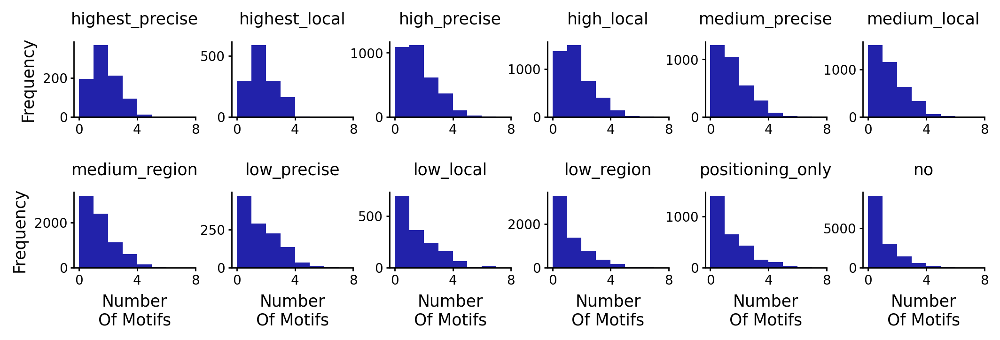

In [421]:
fig, axes = plt.subplots(2, len(SUPPORT_TYPES2) // 2, figsize=(10,2.5), dpi=250)

axes = axes.flatten()

support_types2 = np.array([SUPPORT_TYPES2.index(support) for support in support_labels_top3])[:50000]

for col_i in range(len(SUPPORT_TYPES2)):
    axes[col_i].hist((motif_hit_counts[1] + motif_hit_counts[10])[support_types2 == col_i],
                            alpha = 1, color="#2222AA",
                            bins = np.arange(8))
    
    axes[col_i].set_title(SUPPORT_TYPES2[col_i].replace("_support", ""), fontsize=10, y=1.1)
    
    if col_i > 5:
        axes[col_i].set_xlabel("Number\nOf Motifs", fontsize=10, y=1.1)
    
    if col_i == 0 or col_i == 6:
        axes[col_i].set_ylabel("Frequency", fontsize=10)
    
    axes[col_i].spines[["top", "right"]].set_visible(False)
    
    axes[col_i].set_xticks([0,4,8])
    axes[col_i].tick_params(pad=2, length=2, labelsize=8)
                
plt.subplots_adjust(hspace=1, wspace=0.3)
plt.show()

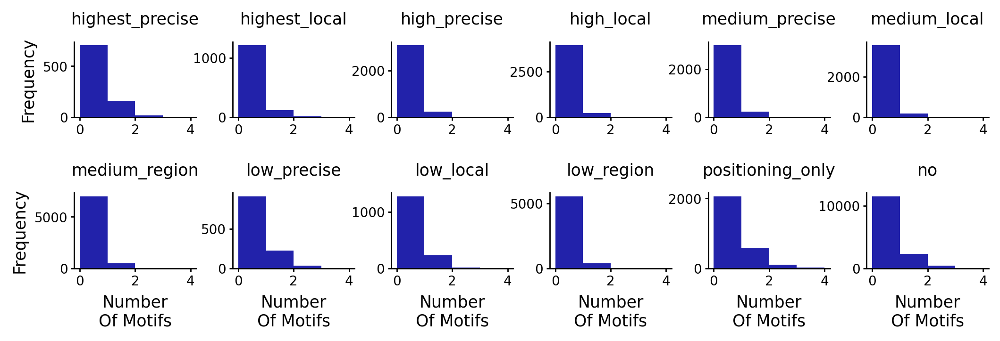

In [420]:
fig, axes = plt.subplots(2, len(SUPPORT_TYPES2) // 2, figsize=(10,2.5), dpi=250)

axes = axes.flatten()

support_types2 = np.array([SUPPORT_TYPES2.index(support) for support in support_labels_top3])[:50000]

for col_i in range(len(SUPPORT_TYPES2)):
    axes[col_i].hist((motif_hit_counts[6] + motif_hit_counts[-1])[support_types2 == col_i],
                            alpha = 1, color="#2222AA",
                            bins = np.arange(5))
    
    axes[col_i].set_title(SUPPORT_TYPES2[col_i].replace("_support", ""), fontsize=10, y=1.1)
    
    if col_i > 5:
        axes[col_i].set_xlabel("Number\nOf Motifs", fontsize=10, y=1.1)
    
    if col_i == 0 or col_i == 6:
        axes[col_i].set_ylabel("Frequency", fontsize=10)
    
    axes[col_i].spines[["top", "right"]].set_visible(False)
    
    axes[col_i].set_xticks([0,2,4])
    axes[col_i].tick_params(pad=2, length=2, labelsize=8)
                
plt.subplots_adjust(hspace=1, wspace=0.3)
plt.show()

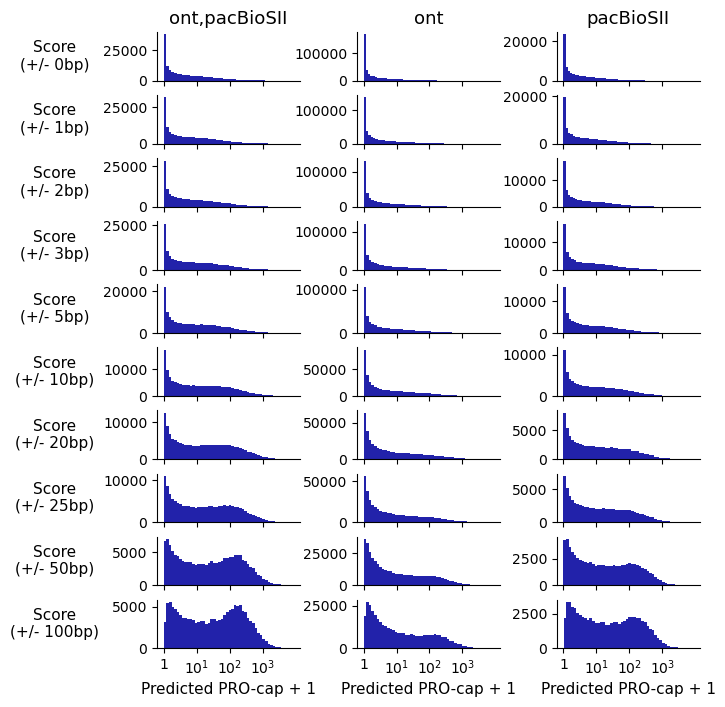

In [259]:
def plot_hist_scores_by_seq_tech(scores_df, score_names, log_scores = False,
                                     xlabel="ProCapNet Score"):
    
    fig, axes = plt.subplots(len(score_names), len(SEQ_TECHS),
                             figsize=(7, 8),
                                      sharex=True)
    
    for row_i, score_name in enumerate(score_names):
        if log_scores:
            scores_row = np.log10(scores_df[score_name] + 1)
        else:
            scores_row = scores_df[score_name]
            
        seq_techs = np.array([SEQ_TECHS.index(seq_tech) for seq_tech in scores_df["seq_tech"]])
    
        for col_i in range(len(SEQ_TECHS)):
            axes[row_i, col_i].hist(scores_row[seq_techs == col_i],
                                    alpha = 1, color="#2222AA",
                                    bins = 50)

            if row_i == 0:
                axes[row_i, col_i].set_title(SEQ_TECHS[col_i], fontsize=13)
            
            axes[row_i, col_i].spines[["top", "right"]].set_visible(False)

            if row_i == len(score_names) - 1:
                axes[row_i, col_i].set_xlabel(xlabel,
                                      fontsize=11)
                
                if log_scores:
                    axes[row_i, col_i].set_xticks([0,1,2,3], ["1", r'$10^1$', r'$10^2$', r'$10^3$'])

            if col_i == 0:
                extend_by = score_name.split("extended_")[1]
                axes[row_i, col_i].set_ylabel("Score\n(+/- " + str(extend_by) + ")", rotation=0,
                                      verticalalignment="center", labelpad=35, fontsize=11)
                
    fig.align_ylabels(axes)
    plt.subplots_adjust(hspace=0.3, wspace=0.4)
    
    plt.show()
    

plot_hist_scores_by_seq_tech(merged_scores["mean"], raw_score_names,
                                 log_scores=True, xlabel="Predicted PRO-cap + 1")

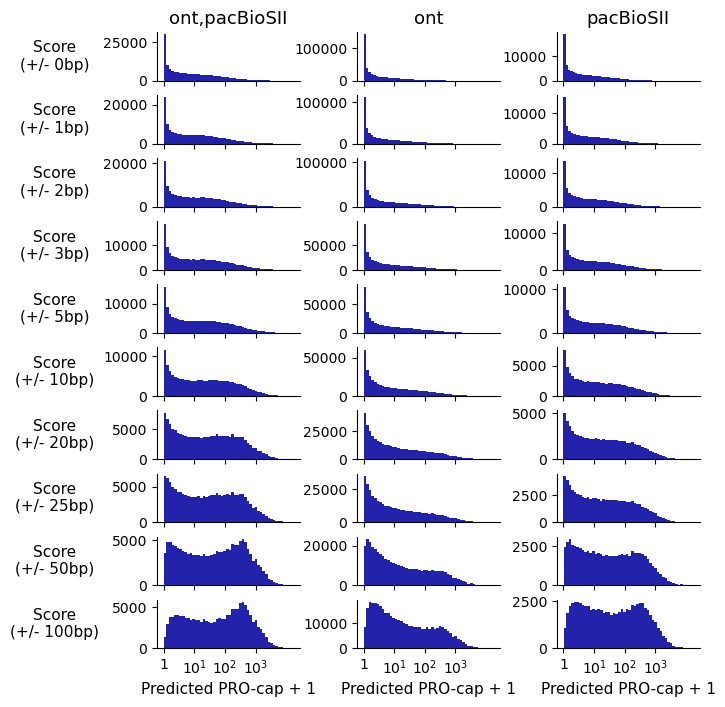

In [260]:
plot_hist_scores_by_seq_tech(merged_scores["max"], raw_score_names,
                                 log_scores=True, xlabel="Predicted PRO-cap + 1")

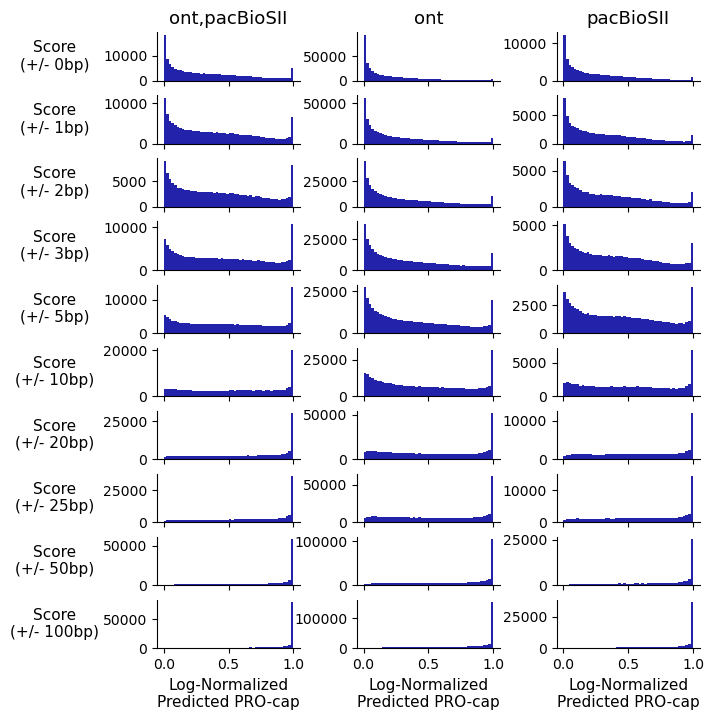

In [261]:
plot_hist_scores_by_seq_tech(merged_scores["mean"], log_norm_score_names,
                                 log_scores=False, xlabel="Log-Normalized\nPredicted PRO-cap")

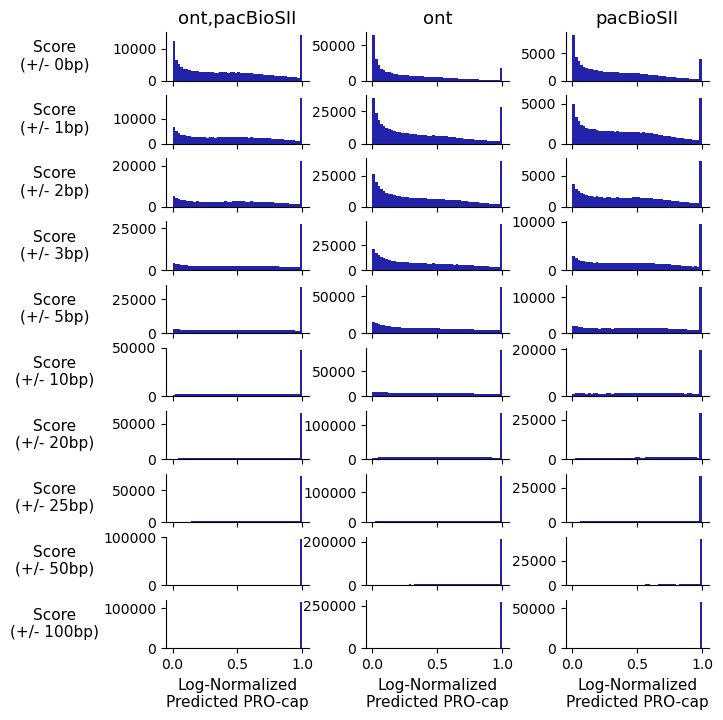

In [262]:
plot_hist_scores_by_seq_tech(merged_scores["max"], log_norm_score_names,
                                 log_scores=False, xlabel="Log-Normalized\nPredicted PRO-cap")

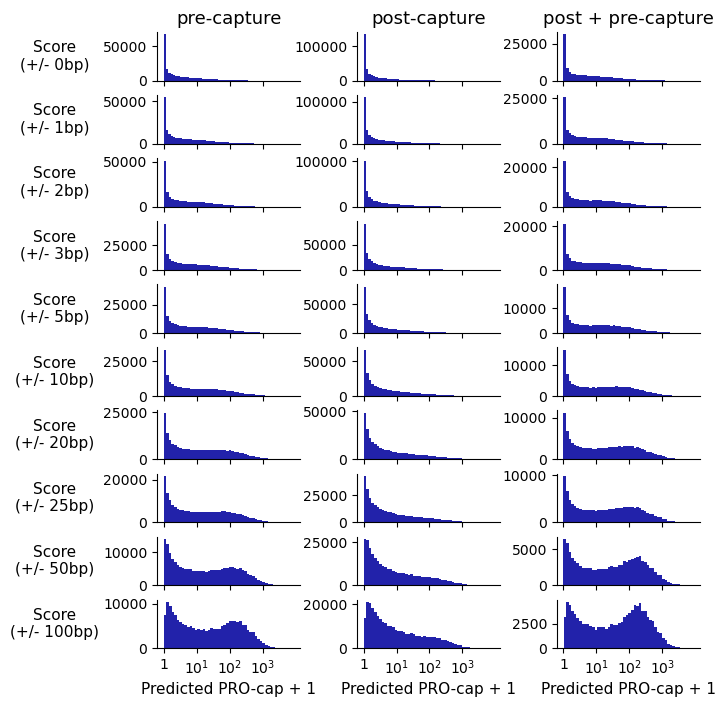

In [263]:
def plot_hist_scores_by_capture_status(scores_df, score_names, log_scores = False,
                                     xlabel="ProCapNet Score"):
    
    fig, axes = plt.subplots(len(score_names), len(CAPTURE_TYPES),
                             figsize=(7, 8),
                                      sharex=True)
    
    for row_i, score_name in enumerate(score_names):
        if log_scores:
            scores_row = np.log10(scores_df[score_name] + 1)
        else:
            scores_row = scores_df[score_name]
            
        capture_types = np.array([CAPTURE_TYPES.index(capture_type) for capture_type in scores_df["capture"]])
    
        for col_i in range(len(CAPTURE_TYPES)):
            axes[row_i, col_i].hist(scores_row[capture_types == col_i],
                                    alpha = 1, color="#2222AA",
                                    bins = 50)

            if row_i == 0:
                if CAPTURE_TYPES[col_i] == "post-capture,pre-capture":
                    axes[row_i, col_i].set_title("post + pre-capture",
                                          fontsize=13)
                else:
                    axes[row_i, col_i].set_title(CAPTURE_TYPES[col_i],
                                          fontsize=13)
            
            axes[row_i, col_i].spines[["top", "right"]].set_visible(False)

            if row_i == len(score_names) - 1:
                axes[row_i, col_i].set_xlabel(xlabel,
                                      fontsize=11)
                
                if log_scores:
                    axes[row_i, col_i].set_xticks([0,1,2,3], ["1", r'$10^1$', r'$10^2$', r'$10^3$'])

            if col_i == 0:
                extend_by = score_name.split("extended_")[1]
                axes[row_i, col_i].set_ylabel("Score\n(+/- " + str(extend_by) + ")", rotation=0,
                                      verticalalignment="center", labelpad=35, fontsize=11)
                
    fig.align_ylabels(axes)
    plt.subplots_adjust(hspace=0.3, wspace=0.4)
    
    plt.show()
    

plot_hist_scores_by_capture_status(merged_scores["mean"], raw_score_names,
                                 log_scores=True, xlabel="Predicted PRO-cap + 1")

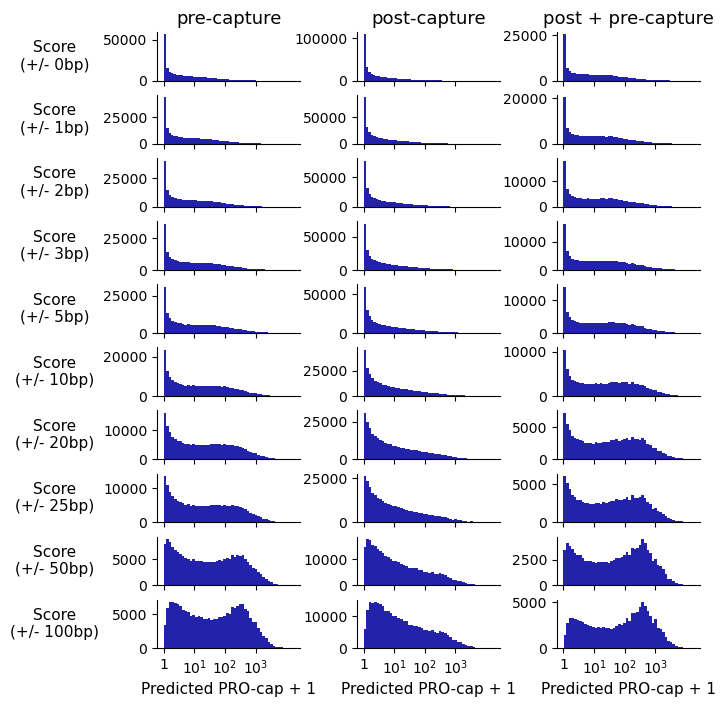

In [264]:
plot_hist_scores_by_capture_status(merged_scores["max"], raw_score_names,
                                 log_scores=True, xlabel="Predicted PRO-cap + 1")

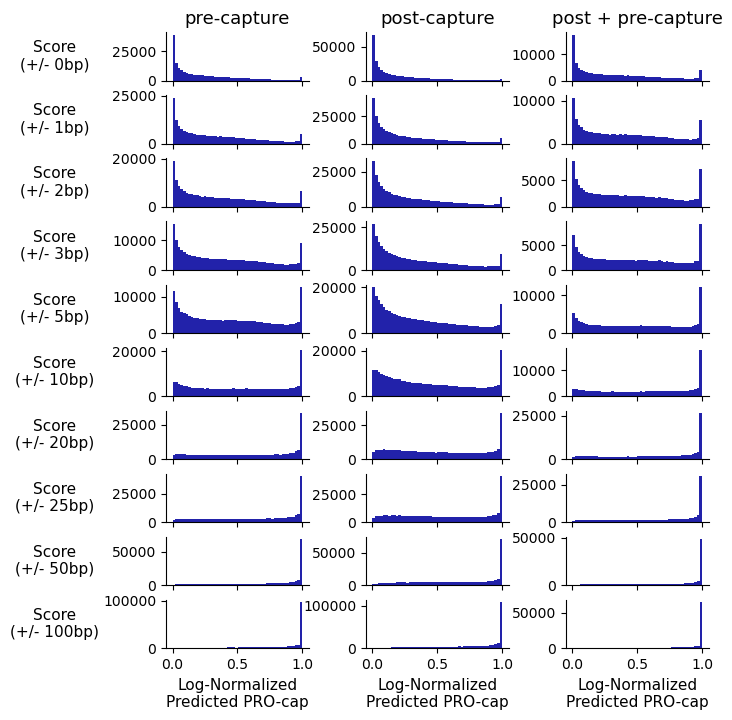

In [265]:
plot_hist_scores_by_capture_status(merged_scores["mean"], log_norm_score_names,
                                 log_scores=False, xlabel="Log-Normalized\nPredicted PRO-cap")

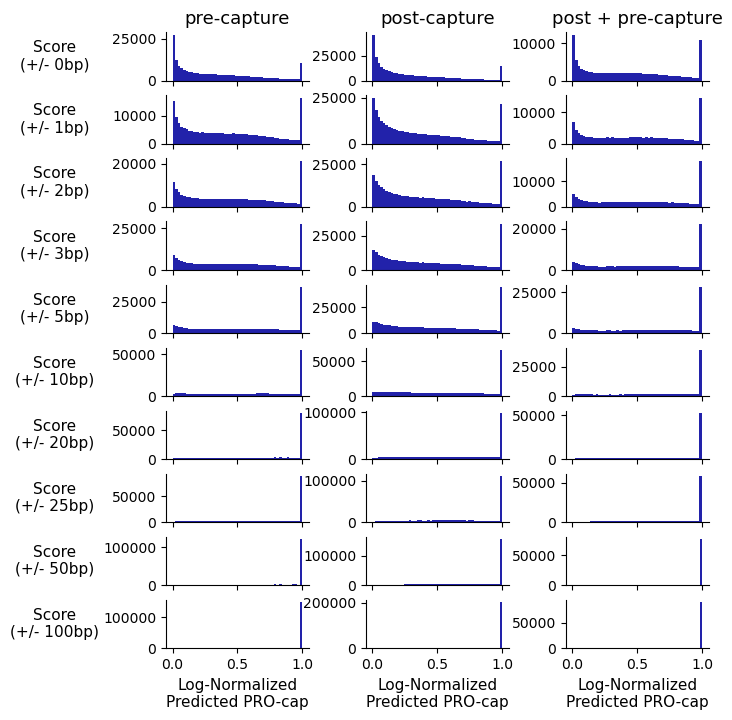

In [266]:
plot_hist_scores_by_capture_status(merged_scores["max"], log_norm_score_names,
                                 log_scores=False, xlabel="Log-Normalized\nPredicted PRO-cap")

In [102]:
import sys
sys.path.append("../utils")
from misc import load_chrom_sizes

chrom_sizes = "genome/hg38.gencode_naming.chrom.sizes"

chrom_sizes_dict = {k : v for (k,v) in load_chrom_sizes(chrom_sizes)}

In [150]:
def extract_observed_profiles_nomax(plus_bw_path, minus_bw_path, peak_path,
                              extend_by = 0, verbose=True):
    signals = []

    names = ['chrom', 'start', 'end', 'strand']
    assert os.path.exists(peak_path), peak_path
    peaks = pd.read_csv(peak_path, sep="\t", usecols=(0, 1, 2, 3), 
        header=None, index_col=False, names=names)

    assert os.path.exists(plus_bw_path), plus_bw_path
    assert os.path.exists(minus_bw_path), minus_bw_path
    plus_bw = pyBigWig.open(plus_bw_path, "r")
    minus_bw = pyBigWig.open(minus_bw_path, "r")

    desc = "Loading Profiles"
    d = not verbose
    for _, (chrom, start, end, strand) in tqdm(peaks.iterrows(), disable=d, desc=desc):
        
        start = start + 1 # this centers on the max prediction in practice so I think correct
        
        if strand == "+":
            try:
                signal = plus_bw.values(chrom, start - extend_by, end + extend_by, numpy=True)
            except:
                signal = plus_bw.values(chrom, max(0, start - extend_by),
                                        min(chrom_sizes_dict[chrom], end + extend_by), numpy=True)
        else:
            try:
                signal = minus_bw.values(chrom, start - extend_by, end + extend_by, numpy=True)[::-1]
            except:
                signal = minus_bw.values(chrom, max(0, start - extend_by),
                                         min(chrom_sizes_dict[chrom], end + extend_by), numpy=True)[::-1]
            
        signal = np.nan_to_num(signal)

        # Append signal to growing signal list
        assert extend_by == 500 or len(signal) == end - start + 2 * extend_by
        
        if len(signal) == extend_by * 2:
            signals.append(signal)
        else:
            # for the tiniest scaffolds, the TSS can be too close to the edge to load a whole window
            empty_arr = np.empty((extend_by * 2))
            empty_arr[:] = np.nan
            signals.append(empty_arr)

    assert len(signals) == len(peaks), (len(signals), len(peaks))
    return np.array(signals)

In [229]:
support_col = merged_scores["mean"]["support"]
seq_techs_col = merged_scores["mean"]["seq_tech"]
capture_col = merged_scores["mean"]["capture"]

In [151]:
preds_at_all_TSSs = dict()

for cell_type in cell_types:
    preds_at_all_TSSs[cell_type] = extract_observed_profiles_nomax(get_preds_bw_path(cell_type, "pos"),
                                                                   get_preds_bw_path(cell_type, "neg"),
                                                                   TSSs_filepath, extend_by=500)

Loading Profiles: 614099it [02:24, 4238.24it/s]
Loading Profiles: 614099it [02:25, 4226.70it/s]
Loading Profiles: 614099it [02:25, 4209.56it/s]
Loading Profiles: 614099it [02:25, 4232.84it/s]
Loading Profiles: 614099it [02:25, 4221.04it/s]
Loading Profiles: 614099it [02:25, 4235.04it/s]


In [220]:
def plot_avg_profiles_by_support(profs_all_cells, support_col, title=None, median=False):
    
    fig, axes = plt.subplots(len(SUPPORT_TYPES), len(cell_types), figsize=(15,3.5), sharex=True)

    transcript_support_nums = np.array([SUPPORT_TYPES.index(support) for support in support_col])
    
    for col_i, (cell_type, profs) in enumerate(profs_all_cells.items()):
        for row_i in range(len(SUPPORT_TYPES)):
            if median:
                if title is None:
                    title = "Median Predicted PRO-cap At CLS TSS Candidates"
                prof_to_plot = np.nanmedian(profs[transcript_support_nums == i], axis=0)
            else:
                if title is None:
                    title = "Avg. Predicted PRO-cap At CLS Candidates"
                prof_to_plot = np.nanmean(profs[transcript_support_nums == row_i], axis=0)
            
            axes[row_i][col_i].plot(range(profs.shape[-1]), prof_to_plot, color="#2222AA")

            axes[row_i][col_i].set_xlim(250, 750)
        
            axes[row_i][col_i].spines[["top", "right"]].set_visible(False)

            axes[row_i][0].set_ylabel(SUPPORT_TYPES[row_i].replace("Supported", ""),
                                      fontsize=12, rotation=0, labelpad=55)
        
        axes[-1][col_i].set_xticks([300, 400, 500, 600, 700], [-200, -100, 0, 100, 200])
        axes[-1][col_i].set_xlabel("Window Centered on TSSs")
        
        axes[0][col_i].set_title(cell_type, fontsize=14)
        
    plt.suptitle(title, y=1.05, fontsize=17)
    
    fig.align_ylabels(axes)
    fig.subplots_adjust(hspace=0.3, wspace=0.3)
    plt.show()

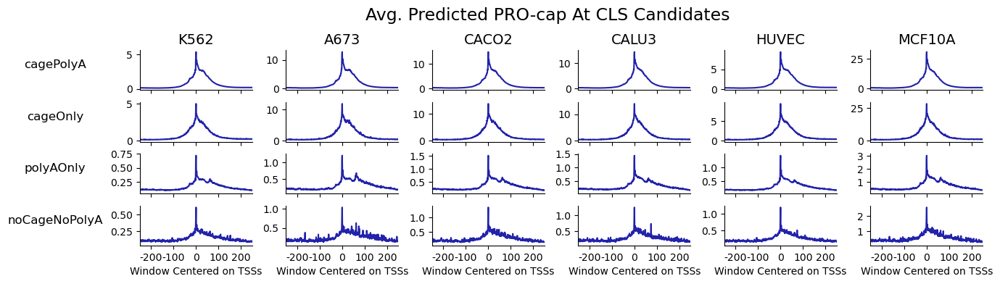

In [221]:
plot_avg_profiles_by_support(preds_at_all_TSSs, support_col)

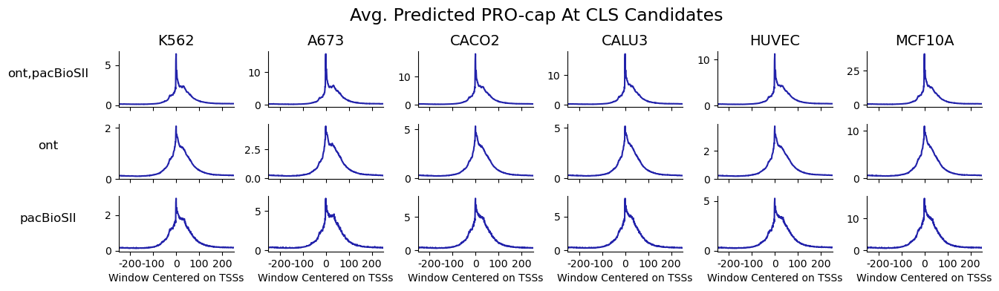

In [225]:
def plot_avg_profiles_by_seq_tech(profs_all_cells, seq_techs_col, title=None, median=False):
    
    fig, axes = plt.subplots(len(SEQ_TECHS), len(cell_types), figsize=(15,3.5), sharex=True)

    seq_tech_nums = np.array([SEQ_TECHS.index(tech) for tech in seq_techs_col])
    
    for col_i, (cell_type, profs) in enumerate(profs_all_cells.items()):
        for row_i in range(len(SEQ_TECHS)):
            if median:
                if title is None:
                    title = "Median Predicted PRO-cap At CLS TSS Candidates"
                prof_to_plot = np.nanmedian(profs[seq_tech_nums == i], axis=0)
            else:
                if title is None:
                    title = "Avg. Predicted PRO-cap At CLS Candidates"
                prof_to_plot = np.nanmean(profs[seq_tech_nums == row_i], axis=0)
            
            axes[row_i][col_i].plot(range(profs.shape[-1]), prof_to_plot, color="#2222AA")

            axes[row_i][col_i].set_xlim(250, 750)
        
            axes[row_i][col_i].spines[["top", "right"]].set_visible(False)

            axes[row_i][0].set_ylabel(SEQ_TECHS[row_i],
                                      fontsize=12, rotation=0, labelpad=55)
        
        axes[-1][col_i].set_xticks([300, 400, 500, 600, 700], [-200, -100, 0, 100, 200])
        axes[-1][col_i].set_xlabel("Window Centered on TSSs")
        
        axes[0][col_i].set_title(cell_type, fontsize=14)
        
    plt.suptitle(title, y=1.05, fontsize=17)
    
    fig.align_ylabels(axes)
    fig.subplots_adjust(hspace=0.3, wspace=0.3)
    plt.show()
    
    
plot_avg_profiles_by_seq_tech(preds_at_all_TSSs, seq_techs_col)

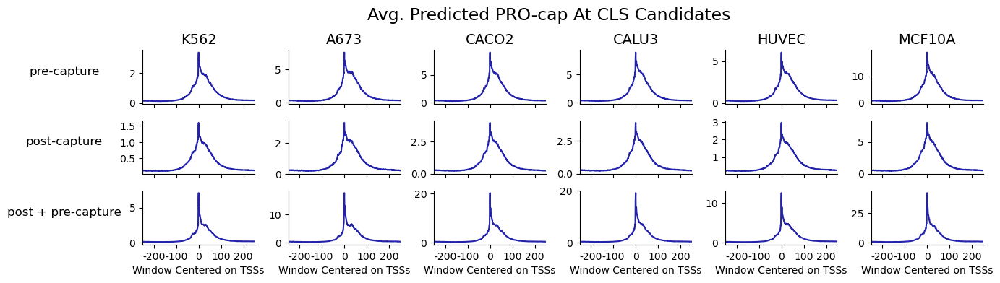

In [234]:
def plot_avg_profiles_by_capture_status(profs_all_cells, capture_col, title=None, median=False):
    
    fig, axes = plt.subplots(len(CAPTURE_TYPES), len(cell_types), figsize=(15,3.5), sharex=True)

    capture_nums = np.array([CAPTURE_TYPES.index(label) for label in capture_col])
    
    for col_i, (cell_type, profs) in enumerate(profs_all_cells.items()):
        for row_i in range(len(CAPTURE_TYPES)):
            if median:
                if title is None:
                    title = "Median Predicted PRO-cap At CLS TSS Candidates"
                prof_to_plot = np.nanmedian(profs[capture_nums == i], axis=0)
            else:
                if title is None:
                    title = "Avg. Predicted PRO-cap At CLS Candidates"
                prof_to_plot = np.nanmean(profs[capture_nums == row_i], axis=0)
            
            axes[row_i][col_i].plot(range(profs.shape[-1]), prof_to_plot, color="#2222AA")

            axes[row_i][col_i].set_xlim(250, 750)
        
            axes[row_i][col_i].spines[["top", "right"]].set_visible(False)

            if CAPTURE_TYPES[row_i] == "post-capture,pre-capture":
                axes[row_i][0].set_ylabel("post + pre-capture",
                                      fontsize=12, rotation=0, labelpad=55)
            else:
                axes[row_i][0].set_ylabel(CAPTURE_TYPES[row_i],
                                      fontsize=12, rotation=0, labelpad=55)
        
        axes[-1][col_i].set_xticks([300, 400, 500, 600, 700], [-200, -100, 0, 100, 200])
        axes[-1][col_i].set_xlabel("Window Centered on TSSs")
        
        axes[0][col_i].set_title(cell_type, fontsize=14)
        
    plt.suptitle(title, y=1.05, fontsize=17)
    
    fig.align_ylabels(axes)
    fig.subplots_adjust(hspace=0.3, wspace=0.3)
    plt.show()
    
    
plot_avg_profiles_by_capture_status(preds_at_all_TSSs, capture_col)

In [195]:
# adapted from Alex Tseng's Tf-Modisco report notebook code

def make_profile_heatmap_matrix(profs):
    assert len(profs.shape) == 2
    
    profs = profs[~np.isnan(profs).any(axis=1)]
    num_profs, width = profs.shape

    # First, normalize the profiles along the output profile dimension
    def normalize(arr, axis=0):
        arr_sum = np.sum(arr, axis=axis, keepdims=True)
        arr_sum[arr_sum == 0] = 1  # If 0, keep 0 as the quotient instead of dividing by 0
        return arr / arr_sum
    profs_norm = normalize(profs, axis=1)

    # Compute the mean profiles across all examples
    profs_mean = np.mean(profs_norm, axis=0)

    cluster_inds = np.argsort(np.argmax(profs_norm, axis=1))
    
    # Compute a matrix of profiles, normalized to the maximum height, ordered by clusters
    def make_matrix(flat_profs, order_inds):
        matrix = flat_profs[order_inds]
        maxes = np.max(matrix, axis=1, keepdims=True)
        maxes[maxes == 0] = 1  # If 0, keep 0 as the quotient instead of dividing by 0
        return matrix / maxes
    
    matrix = make_matrix(profs_norm, cluster_inds)
    return matrix

In [239]:
heatmap_matrix_all_cells_all_supports = dict()
heatmap_matrix_all_cells_all_seq_techs = dict()
heatmap_matrix_all_cells_all_captures = dict()

for cell_type in cell_types:
    print(cell_type)

    heatmap_matrix_all_supports = dict()
    for support in SUPPORT_TYPES:
        profs_to_plot = preds_at_all_TSSs[cell_type][support_col == support]
        heatmap_matrix = make_profile_heatmap_matrix(profs_to_plot)
        heatmap_matrix_all_supports[support] = heatmap_matrix
    heatmap_matrix_all_cells_all_supports[cell_type] = heatmap_matrix_all_supports
    
    heatmap_matrix_all_seq_techs = dict()
    for seq_tech in SEQ_TECHS:
        profs_to_plot = preds_at_all_TSSs[cell_type][seq_techs_col == seq_tech]
        heatmap_matrix = make_profile_heatmap_matrix(profs_to_plot)
        heatmap_matrix_all_seq_techs[seq_tech] = heatmap_matrix
    heatmap_matrix_all_cells_all_seq_techs[cell_type] = heatmap_matrix_all_seq_techs
    
    heatmap_matrix_all_captures = dict()
    for capture_type in CAPTURE_TYPES:
        profs_to_plot = preds_at_all_TSSs[cell_type][capture_col == capture_type]
        heatmap_matrix = make_profile_heatmap_matrix(profs_to_plot)
        heatmap_matrix_all_captures[capture_type] = heatmap_matrix
    heatmap_matrix_all_cells_all_captures[cell_type] = heatmap_matrix_all_captures

K562
A673
CACO2
CALU3
HUVEC
MCF10A


In [243]:
def plot_profile_heatmaps(matrix_dicts):
    # asuming matrix_array is a dict of dict of 2D arrays to make into heatmaps
    num_subplot_rows = len(matrix_dicts)
    num_subplot_cols = len(list(matrix_dicts.values())[0])
    
    # Create a figure with the right dimensions
    fig_height = 1 * num_subplot_rows
    fig_width = 1.2 * num_subplot_cols
    fig, axes = plt.subplots(num_subplot_rows, num_subplot_cols,
                             figsize=(fig_width, fig_height), sharex=True, dpi=200)

    # Plot the heatmaps
    for subplot_row_i, cell_type in enumerate(matrix_dicts.keys()):
        for subplot_col_i, strat_label in enumerate(matrix_dicts[cell_type].keys()):
            ax = axes[subplot_row_i][subplot_col_i]
            matrix = matrix_dicts[cell_type][strat_label]

            ax.imshow(matrix, interpolation="nearest", aspect="auto", cmap="Blues")

            ax.set_ylabel(cell_type, fontsize=7)
            ax.set_xlabel("Distance from TSS (bp)", fontsize=6)
            
            if subplot_row_i == 0:
                ax.set_title(strat_label, fontsize=6)

            width = matrix.shape[1]
            delta = 250
            num_deltas = (width // 2) // delta
            range_start = max(-width // 2, -num_deltas * delta)
            range_end = min(width // 2, num_deltas * delta)
            labels = list(range(range_start, range_end + 1, delta))
            tick_locs = [label + max(width // 2, num_deltas * delta) for label in labels]
            ax.set_xticks(tick_locs, ticklen=2)
            ax.set_xticklabels(labels, fontsize=5)

            ax.set_yticks([])
            ax.set_yticklabels([])
            ax.label_outer()

    plt.suptitle("Sense Strand Predicted PRO-cap At CLS TSSs", fontsize=8)
    
    fig.tight_layout()
    fig.subplots_adjust(hspace=0.1, wspace=0.2)
    plt.show()

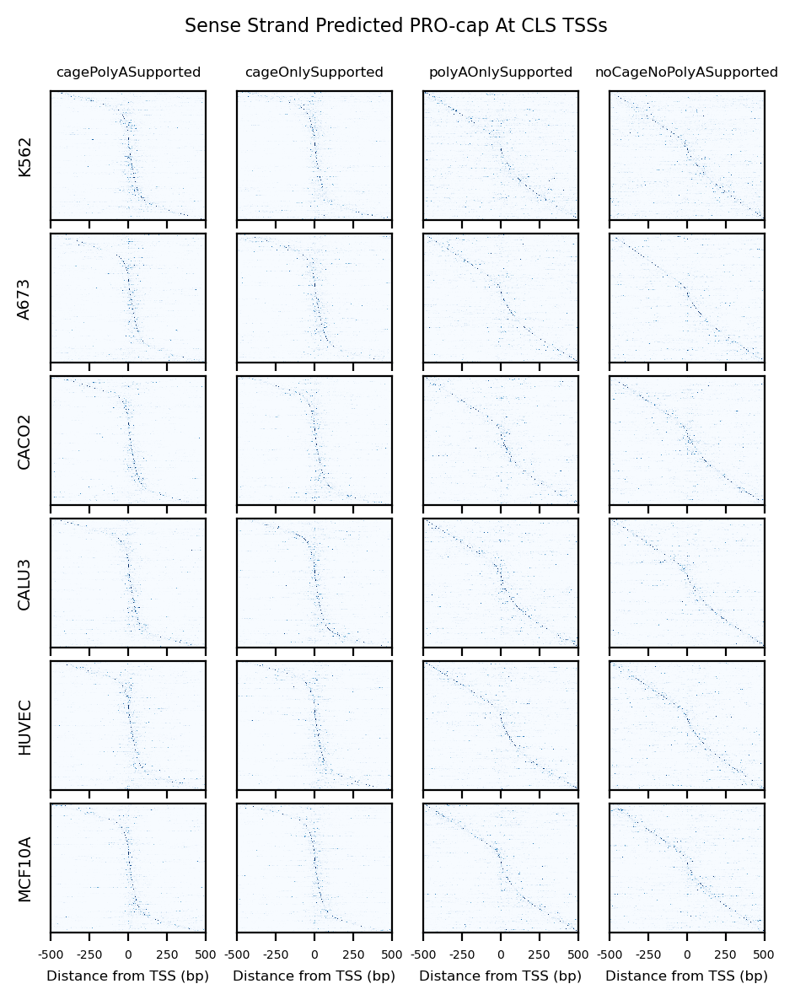

In [244]:
plot_profile_heatmaps(heatmap_matrix_all_cells_all_supports)

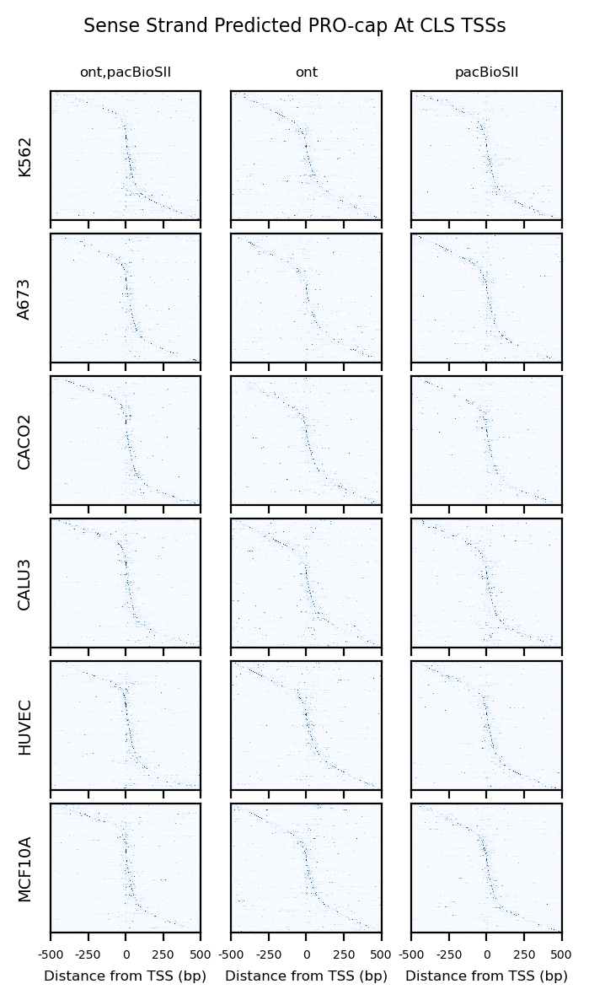

In [245]:
plot_profile_heatmaps(heatmap_matrix_all_cells_all_seq_techs)

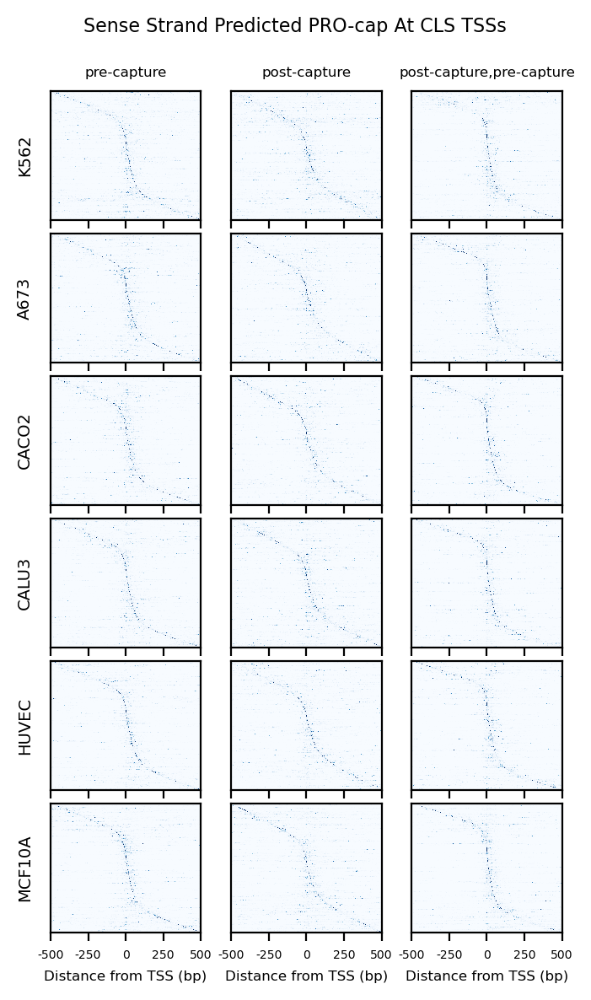

In [246]:
plot_profile_heatmaps(heatmap_matrix_all_cells_all_captures)

In [228]:
# report percents

for support in SUPPORT_TYPES:
    num_TSSs_with_support = np.sum(support_col == support)
    
    profs = preds_at_all_TSSs[cell_type][support_col == support]
    positions_maxTSSs = np.argmax(profs, axis=1)
    num_positions_within_100bp_of_TSSs = np.sum(np.abs(positions_maxTSSs - 500) <= 100)
    
    print(support, num_positions_within_100bp_of_TSSs / num_TSSs_with_support)

cagePolyASupported 0.7218296464884172
cageOnlySupported 0.7329476982405398
polyAOnlySupported 0.3736666376771042
noCageNoPolyASupported 0.316924394028573
